In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder
import seaborn as sns

# Movement Data

In [2]:
data_movement_panda_1 = pd.read_csv('/workspaces/wiggle-face/data-ioana/PANDA1/pose_estimates_r_AIM1.csv')
data_movement_panda_3 = pd.read_csv('/workspaces/wiggle-face/data-ioana/PANDA3/pose_estimates_r_AIM3.csv')

In [3]:
data_movement_panda_1 = data_movement_panda_1.drop(columns = ['fps', 'pixel_x', 'pixel_y', 'time'])
data_movement_panda_3 = data_movement_panda_3.drop(columns = ['fps', 'pixel_x', 'pixel_y', 'time'])

In [4]:
data_movement_panda_1.head(18)

,video_number,video,bp,frame,x,y,c,part_idx
0,0,r_2023_01_18_833180_056_cam3_vid4,Neck,0,1054.470492,413.626907,0.919039,1
1,0,r_2023_01_18_833180_056_cam3_vid4,RShoulder,0,1003.232961,407.317051,0.933992,2
2,0,r_2023_01_18_833180_056_cam3_vid4,RElbow,0,947.555373,436.225617,0.935511,3
3,0,r_2023_01_18_833180_056_cam3_vid4,RWrist,0,964.197967,377.496585,0.959464,4
4,0,r_2023_01_18_833180_056_cam3_vid4,LShoulder,0,1105.708023,419.936762,0.904085,5
5,0,r_2023_01_18_833180_056_cam3_vid4,LElbow,0,1147.549731,490.568027,0.925787,6
6,0,r_2023_01_18_833180_056_cam3_vid4,LWrist,0,1137.762660,424.030199,0.982610,7
7,0,r_2023_01_18_833180_056_cam3_vid4,RHip,0,986.366671,583.202485,0.856169,8
8,0,r_2023_01_18_833180_056_cam3_vid4,RKnee,0,910.977365,637.670003,0.937979,9
9,0,r_2023_01_18_833180_056_cam3_vid4,RAnkle,0,873.309567,725.048963,0.923496,10


In [5]:
# from data_movement_panda_1 and data_movement_panda_3 remove part_idx 14,15,16,17
part_idx_to_remove_just_exrtemities = [0, 1, 2, 5,8,11, 14, 15, 16, 17]
part_idx_to_remove = [0, 14, 15, 16, 17]
data_movement_panda_1 = data_movement_panda_1[~data_movement_panda_1['part_idx'].isin(part_idx_to_remove)]
data_movement_panda_3 = data_movement_panda_3[~data_movement_panda_3['part_idx'].isin(part_idx_to_remove)]

In [6]:
data_movement_panda_3.head(27)

,video_number,video,bp,frame,x,y,c,part_idx
0,0,r_2022_07_28_833180_212_cam3_vid4,Neck,0.0,1099.736612,471.720988,0.943611,1.0
1,0,r_2022_07_28_833180_212_cam3_vid4,RShoulder,0.0,987.112869,474.040660,0.953148,2.0
2,0,r_2022_07_28_833180_212_cam3_vid4,RElbow,0.0,883.468992,540.225377,0.960693,3.0
3,0,r_2022_07_28_833180_212_cam3_vid4,RWrist,0.0,839.315722,442.176839,0.967979,4.0
4,0,r_2022_07_28_833180_212_cam3_vid4,LShoulder,0.0,1212.360354,469.401316,0.934074,5.0
5,0,r_2022_07_28_833180_212_cam3_vid4,LElbow,0.0,1309.806429,535.031015,0.932513,6.0
6,0,r_2022_07_28_833180_212_cam3_vid4,LWrist,0.0,1330.259167,435.189988,0.957025,7.0
7,0,r_2022_07_28_833180_212_cam3_vid4,RHip,0.0,990.866882,823.516345,0.934836,8.0
8,0,r_2022_07_28_833180_212_cam3_vid4,RKnee,0.0,936.706789,973.718092,0.948322,9.0
9,0,r_2022_07_28_833180_212_cam3_vid4,RAnkle,0.0,1048.252964,955.502542,0.559952,10.0


In [7]:
data_movement_panda_1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5400486 entries, 0 to 7477590
Data columns (total 8 columns):
 #   Column        Dtype  
---  ------        -----  
 0   video_number  int64  
 1   video         object 
 2   bp            object 
 3   frame         int64  
 4   x             float64
 5   y             float64
 6   c             float64
 7   part_idx      int64  
dtypes: float64(3), int64(3), object(2)
memory usage: 370.8+ MB


In [8]:
data_movement_panda_3.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 16595887 entries, 0 to 22978912
Data columns (total 8 columns):
 #   Column        Dtype  
---  ------        -----  
 0   video_number  int64  
 1   video         object 
 2   bp            object 
 3   frame         float64
 4   x             float64
 5   y             float64
 6   c             float64
 7   part_idx      float64
dtypes: float64(5), int64(1), object(2)
memory usage: 1.1+ GB


# Clinical Data

In [9]:
file_path = '/workspaces/wiggle-face/data-ioana/CLIN/clin_data_113_infants.csv'
df_clin = pd.read_csv(file_path)

# Ensure 'infant_id' is formatted to three digits
df_clin['infant_id'] = df_clin['infant_id'].apply(lambda x: f"{int(x):03d}")
df_clin['infant_id'] = df_clin['infant_id'].apply(lambda x: int(x))
df_clin.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 113 entries, 0 to 112
Data columns (total 2 columns):
 #   Column        Non-Null Count  Dtype
---  ------        --------------  -----
 0   infant_id     113 non-null    int64
 1   brain_injury  113 non-null    int64
dtypes: int64(2)
memory usage: 1.9 KB


# Emotion Data

In [41]:
data_emotion = pd.read_csv('/workspaces/wiggle-face/src/loading_and_feature_extraction/Data_initial_features_labeled_2.csv')

In [42]:
data_emotion['emotion'] = data_emotion['emotion'].replace('aversion', 'neutral')

In [43]:
def categorize_emotion(emotion):
    if emotion in ['interest', 'surprise', 'playful']:
        return 'positive'
    elif emotion in ['neutral', 'sleepy']:
        return 'neutral'
    elif emotion in ['sadness', 'anger']:
        return 'negative'

def categorize_emotion_2(emotion):
    if emotion in ['anger', 'playful']:
        return 'intense'
    elif emotion in ['neutral', 'sleepy']:
        return 'neutral'
    elif emotion in ['interest', 'surprise', 'sadness']:
        return 'mild'
    
# Apply the categorization function to create 'emotion_category'
data_emotion['emotion_category'] = data_emotion['emotion'].apply(categorize_emotion)
data_emotion['emotion_category_2'] = data_emotion['emotion'].apply(categorize_emotion_2)

In [44]:
data_filtered = data_emotion[data_emotion['age'].isnull()]
data_emotion_panda_1_panda_3 = data_filtered.drop(columns=['age'])
data_emotion_panda_1_panda_3 = data_emotion_panda_1_panda_3[['infant_id','date', 'cam', 'frame_id','emotion', 'emotion_category', 'emotion_category_2']]
data_emotion_panda_1_panda_3.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 448436 entries, 0 to 1285000
Data columns (total 7 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   infant_id           448436 non-null  int64  
 1   date                448436 non-null  float64
 2   cam                 448436 non-null  float64
 3   frame_id            448436 non-null  int64  
 4   emotion             448436 non-null  object 
 5   emotion_category    448436 non-null  object 
 6   emotion_category_2  448436 non-null  object 
dtypes: float64(2), int64(2), object(3)
memory usage: 27.4+ MB


In [45]:
data_emotion_panda_1_panda_3 = data_emotion_panda_1_panda_3.merge(df_clin[['infant_id', 'brain_injury']], on='infant_id', how='inner')

In [46]:
data_emotion_panda_1_panda_3

,infant_id,date,cam,frame_id,emotion,emotion_category,emotion_category_2,brain_injury
0,28,19233.0,3.0,1,neutral,neutral,neutral,0
1,28,19233.0,3.0,2,neutral,neutral,neutral,0
2,28,19233.0,3.0,3,neutral,neutral,neutral,0
3,28,19233.0,3.0,4,neutral,neutral,neutral,0
4,28,19233.0,3.0,5,neutral,neutral,neutral,0
...,...,...,...,...,...,...,...,...
444356,243,19844.0,3.0,7393,neutral,neutral,neutral,1
444357,243,19844.0,3.0,7394,neutral,neutral,neutral,1
444358,243,19844.0,3.0,7395,neutral,neutral,neutral,1
444359,243,19844.0,3.0,7396,neutral,neutral,neutral,1


In [47]:
# Checking the number of unique infant_id
unique_infant_ids = data_emotion_panda_1_panda_3['infant_id'].nunique()
unique_infant_ids

75

In [48]:
data_emotion_panda_1_panda_3['date'] = pd.to_datetime(data_emotion_panda_1_panda_3['date'], origin='1970-01-01', unit='D')
data_emotion_panda_1_panda_3['date'] = data_emotion_panda_1_panda_3['date'].dt.strftime('%Y_%m_%d')
data_emotion_panda_1_panda_3['cam'] = data_emotion_panda_1_panda_3['cam'].astype(int)
data_emotion_panda_1_panda_3['infant_id'] = data_emotion_panda_1_panda_3['infant_id'].apply(lambda x: f"{int(x):03}")

In [49]:
data_emotion_panda_1_panda_3

,infant_id,date,cam,frame_id,emotion,emotion_category,emotion_category_2,brain_injury
0,028,2022_08_29,3,1,neutral,neutral,neutral,0
1,028,2022_08_29,3,2,neutral,neutral,neutral,0
2,028,2022_08_29,3,3,neutral,neutral,neutral,0
3,028,2022_08_29,3,4,neutral,neutral,neutral,0
4,028,2022_08_29,3,5,neutral,neutral,neutral,0
...,...,...,...,...,...,...,...,...
444356,243,2024_05_01,3,7393,neutral,neutral,neutral,1
444357,243,2024_05_01,3,7394,neutral,neutral,neutral,1
444358,243,2024_05_01,3,7395,neutral,neutral,neutral,1
444359,243,2024_05_01,3,7396,neutral,neutral,neutral,1


In [50]:
data_emotion_panda_1_panda_3['video'] = data_emotion_panda_1_panda_3.apply(
    lambda row: f"r_{row['date']}_833180_{row['infant_id']}_cam{row['cam']}_vid4", axis=1
)
data_emotion_panda_1_panda_3 = data_emotion_panda_1_panda_3.drop(columns = ['date', 'cam','infant_id'])
data_emotion_panda_1_panda_3 = data_emotion_panda_1_panda_3.reset_index(drop=True)
data_emotion_panda_1_panda_3.head(90900)

,frame_id,emotion,emotion_category,emotion_category_2,brain_injury,video
0,1,neutral,neutral,neutral,0,r_2022_08_29_833180_028_cam3_vid4
1,2,neutral,neutral,neutral,0,r_2022_08_29_833180_028_cam3_vid4
2,3,neutral,neutral,neutral,0,r_2022_08_29_833180_028_cam3_vid4
3,4,neutral,neutral,neutral,0,r_2022_08_29_833180_028_cam3_vid4
4,5,neutral,neutral,neutral,0,r_2022_08_29_833180_028_cam3_vid4
...,...,...,...,...,...,...
90895,6782,neutral,neutral,neutral,0,r_2022_08_23_833180_026_cam3_vid4
90896,6783,neutral,neutral,neutral,0,r_2022_08_23_833180_026_cam3_vid4
90897,6784,neutral,neutral,neutral,0,r_2022_08_23_833180_026_cam3_vid4
90898,6785,neutral,neutral,neutral,0,r_2022_08_23_833180_026_cam3_vid4


# Normalizing (don't run every time)

In [20]:
# pick 'video' in data_movement_panda_3 and data_movement_panda_1 that are also in data_emotion_panda_1_panda_3

In [21]:
common_videos = data_emotion_panda_1_panda_3['video'].unique()

# Filter data_movement_panda_3 and data_movement_panda_1 to keep only common 'video' values
data_movement_panda_3_filtered = data_movement_panda_3[data_movement_panda_3['video'].isin(common_videos)]
data_movement_panda_1_filtered = data_movement_panda_1[data_movement_panda_1['video'].isin(common_videos)]

data_movement_panda_3_filtered = data_movement_panda_3_filtered.rename(columns={'frame': 'frame_id'})
data_movement_panda_1_filtered = data_movement_panda_1_filtered.rename(columns={'frame': 'frame_id'})

data_movement_panda_3_filtered = data_movement_panda_3_filtered[['video_number','video', 'part_idx', 'x', 'y', 'frame_id']]
data_movement_panda_1_filtered = data_movement_panda_1_filtered[['video_number','video', 'part_idx', 'x', 'y', 'frame_id']]

data_movement_panda_3_filtered = data_movement_panda_3_filtered.reset_index(drop = True)
data_movement_panda_1_filtered = data_movement_panda_1_filtered.reset_index(drop = True)

In [22]:
data_movement_panda_1_filtered.head(20)

,video_number,video,part_idx,x,y,frame_id
0,1,r_2021_07_21_833180_003_cam3_vid4,1,1124.941429,358.426100,0
1,1,r_2021_07_21_833180_003_cam3_vid4,2,1008.415312,361.571348,0
2,1,r_2021_07_21_833180_003_cam3_vid4,3,917.810979,472.143466,0
3,1,r_2021_07_21_833180_003_cam3_vid4,4,822.776221,591.940911,0
4,1,r_2021_07_21_833180_003_cam3_vid4,5,1241.467545,355.280853,0
5,1,r_2021_07_21_833180_003_cam3_vid4,6,1313.727465,506.304796,0
6,1,r_2021_07_21_833180_003_cam3_vid4,7,1328.270015,456.002255,0
7,1,r_2021_07_21_833180_003_cam3_vid4,8,1045.069214,704.292778,0
8,1,r_2021_07_21_833180_003_cam3_vid4,9,1024.411337,898.461495,0
9,1,r_2021_07_21_833180_003_cam3_vid4,10,1023.331435,943.264410,0


In [23]:
def process_frame(chunk):
    # Create new columns for normalized coordinates
    chunk['x_normalized'] = np.nan
    chunk['y_normalized'] = np.nan

    # Use numpy arrays for efficient computation
    video_numbers = chunk['video_number'].values
    frame_ids = chunk['frame_id'].values
    part_idx = chunk['part_idx'].values
    x_coords = chunk['x'].values
    y_coords = chunk['y'].values
    x_normalized = chunk['x_normalized'].values
    y_normalized = chunk['y_normalized'].values

    unique_videos = np.unique(video_numbers)

    for video in unique_videos:
        video_mask = (video_numbers == video)
        video_frames = np.unique(frame_ids[video_mask])

        for frame in video_frames:
            frame_mask = (video_mask & (frame_ids == frame))

            neck_mask = frame_mask & (part_idx == 1)
            if not neck_mask.any():
                continue
            neck_x = x_coords[neck_mask][0]
            neck_y = y_coords[neck_mask][0]

            x_coords[frame_mask] -= neck_x
            y_coords[frame_mask] -= neck_y

            x_normalized[frame_mask] = x_coords[frame_mask]
            y_normalized[frame_mask] = y_coords[frame_mask]

            # right_hip_mask = frame_mask & (part_idx == 8)
            # left_hip_mask = frame_mask & (part_idx == 11)
            # right_shoulder_mask = frame_mask & (part_idx == 2)
            # left_shoulder_mask = frame_mask & (part_idx == 5)

            # if not (right_hip_mask.any() and left_hip_mask.any() and right_shoulder_mask.any() and left_shoulder_mask.any()):
            #     continue

            # right_hip_y = y_coords[right_hip_mask][0]
            # left_hip_y = y_coords[left_hip_mask][0]
            # right_shoulder_y = y_coords[right_shoulder_mask][0]
            # left_shoulder_y = y_coords[left_shoulder_mask][0]
            # trunk_distance = (abs(right_shoulder_y - right_hip_y) + abs(left_shoulder_y - left_hip_y)) / 2

            # x_normalized[frame_mask] = x_coords[frame_mask] / trunk_distance
            # y_normalized[frame_mask] = y_coords[frame_mask] / trunk_distance

    # Assign the normalized coordinates back to the chunk
    chunk['x'] = x_normalized
    chunk['y'] = y_normalized

    # Drop the temporary normalized columns
    chunk.drop(columns=['x_normalized', 'y_normalized'], inplace=True)

    return chunk

def normalize_coordinates_in_chunks(data, chunk_size=1000):
    chunks = [data.iloc[i:i + chunk_size] for i in range(0, len(data), chunk_size)]
    processed_chunks = [process_frame(chunk) for chunk in chunks]
    return pd.concat(processed_chunks, ignore_index=True)

data = data_movement_panda_1_filtered.copy()
data = normalize_coordinates_in_chunks(data)

# Display the result to ensure it's as expected
print(data.head())

/tmp/ipykernel_60186/1208444769.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  chunk['x_normalized'] = np.nan
/tmp/ipykernel_60186/1208444769.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  chunk['y_normalized'] = np.nan
/tmp/ipykernel_60186/1208444769.py:54: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/

   video_number                              video  part_idx           x  \
0             1  r_2021_07_21_833180_003_cam3_vid4         1    0.000000   
1             1  r_2021_07_21_833180_003_cam3_vid4         2 -116.526116   
2             1  r_2021_07_21_833180_003_cam3_vid4         3 -207.130449   
3             1  r_2021_07_21_833180_003_cam3_vid4         4 -302.165208   
4             1  r_2021_07_21_833180_003_cam3_vid4         5  116.526116   

            y  frame_id  
0    0.000000         0  
1    3.145248         0  
2  113.717366         0  
3  233.514811         0  
4   -3.145248         0  


In [24]:
data_movement_panda_1_filtered = data
data_movement_panda_1_filtered

,video_number,video,part_idx,x,y,frame_id
0,1,r_2021_07_21_833180_003_cam3_vid4,1,0.000000,0.000000,0
1,1,r_2021_07_21_833180_003_cam3_vid4,2,-116.526116,3.145248,0
2,1,r_2021_07_21_833180_003_cam3_vid4,3,-207.130449,113.717366,0
3,1,r_2021_07_21_833180_003_cam3_vid4,4,-302.165208,233.514811,0
4,1,r_2021_07_21_833180_003_cam3_vid4,5,116.526116,-3.145248,0
...,...,...,...,...,...,...
3591466,58,r_2023_01_25_833180_060_cam3_vid4,9,-55.515471,285.953061,7425
3591467,58,r_2023_01_25_833180_060_cam3_vid4,10,78.700551,351.169944,7425
3591468,58,r_2023_01_25_833180_060_cam3_vid4,11,89.648281,211.951567,7425
3591469,58,r_2023_01_25_833180_060_cam3_vid4,12,190.521297,162.706589,7425


In [25]:
data_movement_panda_1_filtered.to_csv('/workspaces/wiggle-face/data-ioana/PANDA1/pose_estimates_r_AIM1_2.csv')

In [26]:
# Assuming `data_movement_panda_3_filtered` is your DataFrame
data = data_movement_panda_3_filtered.copy()
data = normalize_coordinates_in_chunks(data)

# Display the result to ensure it's as expected
print(data.head())

/tmp/ipykernel_60186/1208444769.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  chunk['x_normalized'] = np.nan
/tmp/ipykernel_60186/1208444769.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  chunk['y_normalized'] = np.nan
/tmp/ipykernel_60186/1208444769.py:54: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/

   video_number                              video  part_idx           x  \
0             0  r_2022_07_28_833180_212_cam3_vid4       1.0    0.000000   
1             0  r_2022_07_28_833180_212_cam3_vid4       2.0 -112.623743   
2             0  r_2022_07_28_833180_212_cam3_vid4       3.0 -216.267620   
3             0  r_2022_07_28_833180_212_cam3_vid4       4.0 -260.420890   
4             0  r_2022_07_28_833180_212_cam3_vid4       5.0  112.623743   

           y  frame_id  
0   0.000000       0.0  
1   2.319672       0.0  
2  68.504389       0.0  
3 -29.544149       0.0  
4  -2.319672       0.0  


In [27]:
data_movement_panda_3_filtered = data
data_movement_panda_3_filtered

,video_number,video,part_idx,x,y,frame_id
0,0,r_2022_07_28_833180_212_cam3_vid4,1.0,0.000000,0.000000,0.0
1,0,r_2022_07_28_833180_212_cam3_vid4,2.0,-112.623743,2.319672,0.0
2,0,r_2022_07_28_833180_212_cam3_vid4,3.0,-216.267620,68.504389,0.0
3,0,r_2022_07_28_833180_212_cam3_vid4,4.0,-260.420890,-29.544149,0.0
4,0,r_2022_07_28_833180_212_cam3_vid4,5.0,112.623743,-2.319672,0.0
...,...,...,...,...,...,...
12985183,186,r_2021_11_11_833180_201_cam3_vid4,9.0,-177.527722,219.719576,7537.0
12985184,186,r_2021_11_11_833180_201_cam3_vid4,10.0,-230.786517,228.431031,7537.0
12985185,186,r_2021_11_11_833180_201_cam3_vid4,11.0,93.713746,343.967415,7537.0
12985186,186,r_2021_11_11_833180_201_cam3_vid4,12.0,211.525765,212.197231,7537.0


In [28]:
data_movement_panda_3_filtered['frame_id'] = data_movement_panda_3_filtered['frame_id'].astype(int)
data_movement_panda_3_filtered['part_idx'] = data_movement_panda_3_filtered['part_idx'].astype(int)
data_movement_panda_3_filtered

,video_number,video,part_idx,x,y,frame_id
0,0,r_2022_07_28_833180_212_cam3_vid4,1,0.000000,0.000000,0
1,0,r_2022_07_28_833180_212_cam3_vid4,2,-112.623743,2.319672,0
2,0,r_2022_07_28_833180_212_cam3_vid4,3,-216.267620,68.504389,0
3,0,r_2022_07_28_833180_212_cam3_vid4,4,-260.420890,-29.544149,0
4,0,r_2022_07_28_833180_212_cam3_vid4,5,112.623743,-2.319672,0
...,...,...,...,...,...,...
12985183,186,r_2021_11_11_833180_201_cam3_vid4,9,-177.527722,219.719576,7537
12985184,186,r_2021_11_11_833180_201_cam3_vid4,10,-230.786517,228.431031,7537
12985185,186,r_2021_11_11_833180_201_cam3_vid4,11,93.713746,343.967415,7537
12985186,186,r_2021_11_11_833180_201_cam3_vid4,12,211.525765,212.197231,7537


In [29]:
data_movement_panda_3_filtered.to_csv('/workspaces/wiggle-face/data-ioana/PANDA3/pose_estimates_r_AIM3_2.csv')

# Integrating

In [20]:
data_movement_panda_1_filtered = pd.read_csv('/workspaces/wiggle-face/data-ioana/PANDA1/pose_estimates_r_AIM1_2.csv')
data_movement_panda_3_filtered = pd.read_csv('/workspaces/wiggle-face/data-ioana/PANDA3/pose_estimates_r_AIM3_2.csv')
data_movement_panda_1_filtered = data_movement_panda_1_filtered.drop(columns=['Unnamed: 0'])
data_movement_panda_3_filtered = data_movement_panda_3_filtered.drop(columns=['Unnamed: 0'])

In [21]:
common_videos = data_emotion_panda_1_panda_3['video'].unique()

# Filter data_movement_panda_3 and data_movement_panda_1 to keep only common 'video' values
data_movement_panda_3_filtered = data_movement_panda_3[data_movement_panda_3['video'].isin(common_videos)]
data_movement_panda_1_filtered = data_movement_panda_1[data_movement_panda_1['video'].isin(common_videos)]

data_movement_panda_3_filtered = data_movement_panda_3_filtered.rename(columns={'frame': 'frame_id'})
data_movement_panda_1_filtered = data_movement_panda_1_filtered.rename(columns={'frame': 'frame_id'})

data_movement_panda_3_filtered = data_movement_panda_3_filtered[['video_number','video', 'part_idx', 'x', 'y', 'frame_id']]
data_movement_panda_1_filtered = data_movement_panda_1_filtered[['video_number','video', 'part_idx', 'x', 'y', 'frame_id']]

data_movement_panda_3_filtered = data_movement_panda_3_filtered.reset_index(drop = True)
data_movement_panda_1_filtered = data_movement_panda_1_filtered.reset_index(drop = True)

In [22]:
def euclidean_distance(df):
    df = df.sort_values(by='frame_id')
    df['x_diff'] = df['x'].diff()
    df['y_diff'] = df['y'].diff()
    df['distance'] = np.sqrt(df['x_diff']**2 + df['y_diff']**2)
    return df

def normalize_distances(df):
    #min_distance = df['distance'].min()
    #max_distance = df['distance'].max()
    #df['distance'] = (df['distance'] - min_distance) / (max_distance - min_distance)#*10e4
    df['distance'] = df['distance'] / df['trunk_length']
    return df

def calculate_trunk_length_for_frame(df, frame_id):
    try:
        right_hip_y = df.loc[(df['part_idx'] == 8) & (df['frame_id'] == frame_id), 'y'].values[0]
        left_hip_y = df.loc[(df['part_idx'] == 11) & (df['frame_id'] == frame_id), 'y'].values[0]
        right_shoulder_y = df.loc[(df['part_idx'] == 2) & (df['frame_id'] == frame_id), 'y'].values[0]
        left_shoulder_y = df.loc[(df['part_idx'] == 5) & (df['frame_id'] == frame_id), 'y'].values[0]
        trunk_length = (abs(right_shoulder_y - right_hip_y) + abs(left_shoulder_y - left_hip_y)) / 2
    except IndexError:
        trunk_length = np.nan  # Set trunk length to NaN if any required part is missing
    return trunk_length

def calculate_trunk_lengths(df):
    unique_videos = df['video'].unique()
    trunk_lengths = []

    for video in unique_videos:
        video_df = df[df['video'] == video]
        unique_frames = video_df['frame_id'].unique()
        
        for frame in unique_frames:
            trunk_length = calculate_trunk_length_for_frame(video_df, frame)
            trunk_lengths.append({
                'video': video,
                'frame_id': frame,
                'trunk_length': trunk_length
            })
    
    return pd.DataFrame(trunk_lengths)

In [23]:
data_movement_panda_3_filtered['frame_id'] = data_movement_panda_3_filtered['frame_id'].astype(int)
data_movement_panda_3_filtered['part_idx'] = data_movement_panda_3_filtered['part_idx'].astype(int)

data_movement_panda_1_filtered = data_movement_panda_1_filtered.groupby(['video', 'part_idx'], group_keys=False).apply(euclidean_distance)
data_movement_panda_3_filtered = data_movement_panda_3_filtered.groupby(['video', 'part_idx'], group_keys=False).apply(euclidean_distance)

trunk_1_lengths_df = calculate_trunk_lengths(data_movement_panda_1_filtered)
data_movement_panda_1_filtered = data_movement_panda_1_filtered.merge(trunk_1_lengths_df, on=['video', 'frame_id'], how='left')
trunk_3_lengths_df = calculate_trunk_lengths(data_movement_panda_3_filtered)
data_movement_panda_3_filtered = data_movement_panda_3_filtered.merge(trunk_3_lengths_df, on=['video', 'frame_id'], how='left')

data_movement_panda_1_filtered = data_movement_panda_1_filtered.dropna().reset_index(drop=True)
data_movement_panda_3_filtered = data_movement_panda_3_filtered.dropna().reset_index(drop=True)
data_movement_panda_1_filtered = normalize_distances(data_movement_panda_1_filtered)
data_movement_panda_3_filtered = normalize_distances(data_movement_panda_3_filtered)
data_movement_panda_1_filtered['distance'] = data_movement_panda_1_filtered['distance'] * 100 # just for graphing
data_movement_panda_3_filtered['distance'] = data_movement_panda_3_filtered['distance'] * 100 # just for graphing

In [24]:
#data_movement_panda_1_filtered = data_movement_panda_1_filtered.groupby(['video']).apply(normalize_distances)
#data_movement_panda_3_filtered = data_movement_panda_3_filtered.groupby(['video']).apply(normalize_distances)

df_sum_1 = data_movement_panda_1_filtered.groupby(['video', 'frame_id'], group_keys=False)['distance'].sum().reset_index()
df_sum_3 = data_movement_panda_3_filtered.groupby(['video', 'frame_id'], group_keys=False)['distance'].sum().reset_index()

df_sum_1['smoothed_distance'] = df_sum_1.groupby('video')['distance'].rolling(window=3).mean().reset_index(level=0, drop=True)
df_sum_3['smoothed_distance'] = df_sum_3.groupby('video')['distance'].rolling(window=3).mean().reset_index(level=0, drop=True)
df_sum_1 = df_sum_1.reset_index(drop = True)
df_sum_3 = df_sum_3.reset_index(drop = True)

In [25]:
df_sum_1['acceleration'] = abs(df_sum_1.groupby('video')['smoothed_distance'].diff().fillna(0))
df_sum_3['acceleration'] = abs(df_sum_3.groupby('video')['smoothed_distance'].diff().fillna(0))

# Apply a rolling mean to smooth the accelerations
df_sum_1 = df_sum_1.dropna().reset_index(drop=True)
df_sum_3 = df_sum_3.dropna().reset_index(drop=True)

In [26]:
df_sum_3

,video,frame_id,distance,smoothed_distance,acceleration
0,r_2021_07_26_833180_201_cam3_vid4,3,6.591623,5.555897,0.000000
1,r_2021_07_26_833180_201_cam3_vid4,4,6.534318,6.418779,0.862882
2,r_2021_07_26_833180_201_cam3_vid4,5,5.566378,6.230773,0.188006
3,r_2021_07_26_833180_201_cam3_vid4,6,6.358817,6.153171,0.077602
4,r_2021_07_26_833180_201_cam3_vid4,7,4.791101,5.572099,0.581072
...,...,...,...,...,...
998444,r_2024_06_07_833180_239_cam3_vid4,7630,8.186151,7.963678,0.500602
998445,r_2024_06_07_833180_239_cam3_vid4,7631,6.956706,7.169121,0.794557
998446,r_2024_06_07_833180_239_cam3_vid4,7632,10.674205,8.605687,1.436566
998447,r_2024_06_07_833180_239_cam3_vid4,7633,8.165869,8.598927,0.006761


In [27]:
df_smmothed_filtered_kinematics = pd.concat([df_sum_1, df_sum_3], ignore_index=True)
df_smmothed_filtered_kinematics

,video,frame_id,distance,smoothed_distance,acceleration
0,r_2021_07_21_833180_003_cam3_vid4,3,6.391164,6.763975,0.000000
1,r_2021_07_21_833180_003_cam3_vid4,4,5.925951,5.838199,0.925776
2,r_2021_07_21_833180_003_cam3_vid4,5,7.463963,6.593692,0.755493
3,r_2021_07_21_833180_003_cam3_vid4,6,6.259263,6.549726,0.043967
4,r_2021_07_21_833180_003_cam3_vid4,7,5.968849,6.564025,0.014299
...,...,...,...,...,...
1274600,r_2024_06_07_833180_239_cam3_vid4,7630,8.186151,7.963678,0.500602
1274601,r_2024_06_07_833180_239_cam3_vid4,7631,6.956706,7.169121,0.794557
1274602,r_2024_06_07_833180_239_cam3_vid4,7632,10.674205,8.605687,1.436566
1274603,r_2024_06_07_833180_239_cam3_vid4,7633,8.165869,8.598927,0.006761


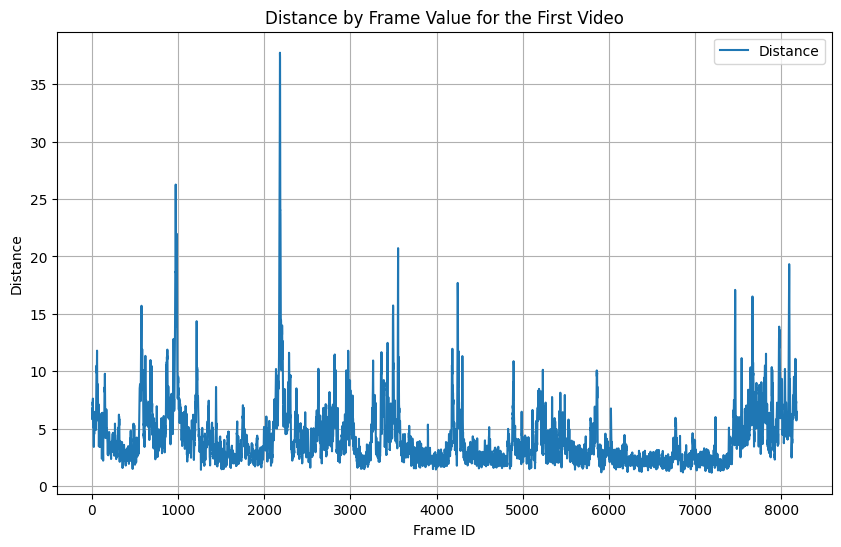

In [28]:
first_video = df_smmothed_filtered_kinematics[df_smmothed_filtered_kinematics['video'] == 'r_2021_07_21_833180_003_cam3_vid4']

# Plot the data
plt.figure(figsize=(10, 6))
plt.plot(first_video['frame_id'], first_video['smoothed_distance'], label='Distance')
plt.xlabel('Frame ID')
plt.ylabel('Distance')
plt.title('Distance by Frame Value for the First Video')
plt.legend()
plt.grid(True)
plt.show()

In [29]:
data_emotion_panda_1_panda_3

,frame_id,emotion,emotion_category,emotion_category_2,brain_injury,video
0,1,neutral,neutral,neutral,0,r_2022_08_29_833180_028_cam3_vid4
1,2,neutral,neutral,neutral,0,r_2022_08_29_833180_028_cam3_vid4
2,3,neutral,neutral,neutral,0,r_2022_08_29_833180_028_cam3_vid4
3,4,neutral,neutral,neutral,0,r_2022_08_29_833180_028_cam3_vid4
4,5,neutral,neutral,neutral,0,r_2022_08_29_833180_028_cam3_vid4
...,...,...,...,...,...,...
444356,7393,neutral,neutral,neutral,1,r_2024_05_01_833180_243_cam3_vid4
444357,7394,neutral,neutral,neutral,1,r_2024_05_01_833180_243_cam3_vid4
444358,7395,neutral,neutral,neutral,1,r_2024_05_01_833180_243_cam3_vid4
444359,7396,neutral,neutral,neutral,1,r_2024_05_01_833180_243_cam3_vid4


In [51]:
# i now wanna join data_emotion_panda_1_panda_3 and df_smmothed_filtered_kinematics on 'video'
df_merged = pd.merge(data_emotion_panda_1_panda_3, df_smmothed_filtered_kinematics, on=['video', 'frame_id'], how='inner')

# Plotting corelations with clin data

In [63]:
df_merged

,frame_id,emotion,emotion_category,emotion_category_2,brain_injury,video,distance,smoothed_distance,acceleration
0,3,neutral,neutral,neutral,0,r_2022_08_29_833180_028_cam3_vid4,5.730059,7.313038,0.000000
1,4,neutral,neutral,neutral,0,r_2022_08_29_833180_028_cam3_vid4,4.699013,6.312081,1.000957
2,5,neutral,neutral,neutral,0,r_2022_08_29_833180_028_cam3_vid4,4.349483,4.926185,1.385897
3,6,neutral,neutral,neutral,0,r_2022_08_29_833180_028_cam3_vid4,4.419792,4.489429,0.436756
4,7,neutral,neutral,neutral,0,r_2022_08_29_833180_028_cam3_vid4,4.361865,4.377047,0.112382
...,...,...,...,...,...,...,...,...,...
440281,7393,neutral,neutral,neutral,1,r_2024_05_01_833180_243_cam3_vid4,5.944898,7.922126,0.025520
440282,7394,neutral,neutral,neutral,1,r_2024_05_01_833180_243_cam3_vid4,6.085811,7.519496,0.402630
440283,7395,neutral,neutral,neutral,1,r_2024_05_01_833180_243_cam3_vid4,7.930666,6.653792,0.865704
440284,7396,neutral,neutral,neutral,1,r_2024_05_01_833180_243_cam3_vid4,7.711365,7.242614,0.588822


In [64]:
df = df_merged.copy()

# Create a new column for block ids
df['block_id'] = df['frame_id'] // 5

# Function to calculate the mean displacement
def calculate_mean_displacement(block):
    return block['smoothed_distance'].mean()

# Function to find the dominant emotion and emotion category
def find_dominant_emotion(block):
    dominant_emotion = block['emotion'].mode()[0]
    dominant_emotion_category = block['emotion_category'].mode()[0]
    dominant_emotion_category_2 = block['emotion_category_2'].mode()[0]
    brain_injury= block['brain_injury'].mode()[0]
    return pd.Series([dominant_emotion, dominant_emotion_category, dominant_emotion_category_2, brain_injury], index=['dominant_emotion', 'dominant_emotion_category', 'dominant_emotion_category_2', 'brain_injury'])

# Group by video and block_id, then apply the functions
result_df = df.groupby(['video', 'block_id']).apply(lambda block: pd.Series({
    #'video': block['video'].iloc[0],
    'distance': calculate_mean_displacement(block),
    'brain_injury': find_dominant_emotion(block)['brain_injury'],
    'emotion': find_dominant_emotion(block)['dominant_emotion'],
    'emotion_category': find_dominant_emotion(block)['dominant_emotion_category'],
    'emotion_category_2': find_dominant_emotion(block)['dominant_emotion_category_2']
})).reset_index()

In [65]:
result_df

,video,block_id,distance,brain_injury,emotion,emotion_category,emotion_category_2
0,r_2021_07_21_833180_003_cam3_vid4,0,6.301087,0,neutral,neutral,neutral
1,r_2021_07_21_833180_003_cam3_vid4,1,6.567798,0,neutral,neutral,neutral
2,r_2021_07_21_833180_003_cam3_vid4,2,6.847526,0,neutral,neutral,neutral
3,r_2021_07_21_833180_003_cam3_vid4,3,4.940139,0,neutral,neutral,neutral
4,r_2021_07_21_833180_003_cam3_vid4,4,3.727641,0,neutral,neutral,neutral
...,...,...,...,...,...,...,...
94135,r_2024_06_07_833180_239_cam3_vid4,358,14.580994,1,neutral,neutral,neutral
94136,r_2024_06_07_833180_239_cam3_vid4,359,10.454222,1,neutral,neutral,neutral
94137,r_2024_06_07_833180_239_cam3_vid4,360,12.024891,1,neutral,neutral,neutral
94138,r_2024_06_07_833180_239_cam3_vid4,361,8.395568,1,neutral,neutral,neutral


In [66]:
merged_df = result_df
merged_df

,video,block_id,distance,brain_injury,emotion,emotion_category,emotion_category_2
0,r_2021_07_21_833180_003_cam3_vid4,0,6.301087,0,neutral,neutral,neutral
1,r_2021_07_21_833180_003_cam3_vid4,1,6.567798,0,neutral,neutral,neutral
2,r_2021_07_21_833180_003_cam3_vid4,2,6.847526,0,neutral,neutral,neutral
3,r_2021_07_21_833180_003_cam3_vid4,3,4.940139,0,neutral,neutral,neutral
4,r_2021_07_21_833180_003_cam3_vid4,4,3.727641,0,neutral,neutral,neutral
...,...,...,...,...,...,...,...
94135,r_2024_06_07_833180_239_cam3_vid4,358,14.580994,1,neutral,neutral,neutral
94136,r_2024_06_07_833180_239_cam3_vid4,359,10.454222,1,neutral,neutral,neutral
94137,r_2024_06_07_833180_239_cam3_vid4,360,12.024891,1,neutral,neutral,neutral
94138,r_2024_06_07_833180_239_cam3_vid4,361,8.395568,1,neutral,neutral,neutral


In [67]:
unique_video_ids = merged_df['video'].nunique()
unique_video_ids

174

In [68]:
# df_merged.loc[df_merged['emotion'] == 'aversion', 'emotion'] = 'neutral'
from scipy.stats import f_oneway
from statsmodels.stats.multicomp import pairwise_tukeyhsd
from sklearn.preprocessing import LabelEncoder

In [69]:
df = merged_df

/tmp/ipykernel_13162/3298704642.py:35: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-whitegrid')


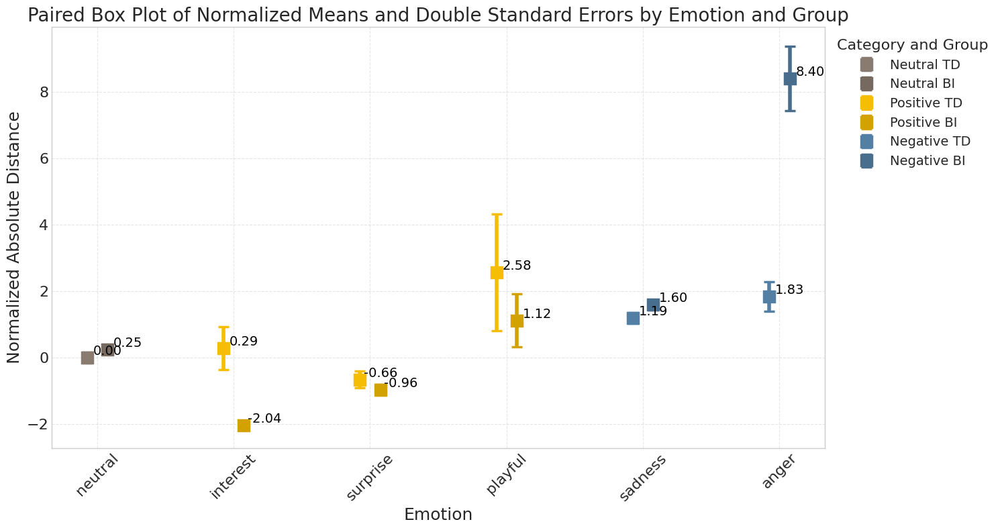

In [70]:
# df = df[df['emotion'] != 'sleepy']
label_encoder = LabelEncoder()
df['emotion_encoded'] = label_encoder.fit_transform(df['emotion'])

# Map encoded values back to emotions and manually order them
ordered_emotions = ['neutral', 'interest', 'surprise', 'playful', 'sadness', 'anger']
df['emotion'] = pd.Categorical(df['emotion'], categories=ordered_emotions, ordered=True)
df.sort_values('emotion', inplace=True)  # Sort based on the custom order

# Convert distances to absolute values
df['abs_distance'] = df['distance'].abs()

# Recalculate emotion_encoded to reflect the new order
df['emotion_encoded'] = label_encoder.fit_transform(df['emotion'])

# Calculate means and standard errors for 'TD' (TD) and 'BI' (BI) groups
mean_se_injured = df[df['brain_injury'] == True].groupby('emotion_encoded')['abs_distance'].agg(
    mean='mean', se=lambda x: np.std(x) / np.sqrt(len(x) * 2)).reset_index()
mean_se_injured['emotion'] = label_encoder.inverse_transform(mean_se_injured['emotion_encoded'])
mean_se_injured['group'] = 'BI'

mean_se_typical = df[df['brain_injury'] == False].groupby('emotion_encoded')['abs_distance'].agg(
    mean='mean', se=lambda x: np.std(x) / np.sqrt(len(x)) * 2).reset_index()
mean_se_typical['emotion'] = label_encoder.inverse_transform(mean_se_typical['emotion_encoded'])
mean_se_typical['group'] = 'TD'

# Combine 'TD' and 'BI' data
mean_se_combined = pd.concat([mean_se_injured, mean_se_typical])

# Normalize by setting 'neutral' in 'TD' group as baseline
neutral_mean_typical = mean_se_typical.loc[mean_se_typical['emotion'] == 'neutral', 'mean'].values[0]
mean_se_combined['normalized_mean'] = mean_se_combined['mean'] - neutral_mean_typical

# Set the style for the plot
plt.style.use('seaborn-whitegrid')

# Define specific color shades for Neutral, Positive, and Negative categories
color_map = {
    'neutral': ('#897b70', '#756960'),  # Light Grey, Dark Grey
    'positive': ('#f5bd03', '#d2a203'),  # Light Yellow, Dark Yellow
    'negative': ('#547fa5', '#486d8d')   # Light Blue, Dark Blue
}

# Assign colors to emotions based on their categories
emotion_color_map = {
    'neutral': color_map['neutral'],
    'interest': color_map['positive'],
    'surprise': color_map['positive'],
    'playful': color_map['positive'],
    'sadness': color_map['negative'],
    'anger': color_map['negative']
}

# Plot the data using error bars and symbolic boxes
fig, ax = plt.subplots(figsize=(15, 8))
x_labels = []
x_ticks = []

for i, emotion in enumerate(ordered_emotions):
    for group in ['TD', 'BI']:
        subset = mean_se_combined[(mean_se_combined['emotion'] == emotion) & (mean_se_combined['group'] == group)]
        if not subset.empty:
            offset = {'TD': i * 2 - 0.15, 'BI': i * 2 + 0.15}[group]
            category = 'neutral' if emotion == 'neutral' else ('positive' if emotion in ['interest', 'surprise', 'playful'] else 'negative')
            color = color_map[category][0] if group == 'TD' else color_map[category][1]
            ax.errorbar(offset, subset['normalized_mean'], yerr=subset['se'], fmt='s', capsize=6,
                        elinewidth=4, markeredgewidth=2.5, markersize=12, color=color, label=f"{category.capitalize()} {group}")
            ax.text(offset + 0.3, subset['normalized_mean'], f"{subset['normalized_mean'].values[0]:.2f}",
                    horizontalalignment='center', verticalalignment='bottom', fontsize=14, color='black')

            if group == 'TD':
                x_labels.append(emotion)
                x_ticks.append(i * 2)

ax.set_xlabel('Emotion', fontsize=18)
ax.set_ylabel('Normalized Absolute Distance', fontsize=18)
ax.set_title('Paired Box Plot of Normalized Means and Double Standard Errors by Emotion and Group', fontsize=20)
ax.set_xticks(x_ticks)
ax.set_xticklabels(x_labels, rotation=45, fontsize=16)
ax.tick_params(axis='y', labelsize=16)
ax.grid(True, linestyle='--', alpha=0.5)

# Handling legend to show each color and label correctly
handles, labels = plt.gca().get_legend_handles_labels()
label_handle_dict = dict(zip(labels, handles))  # Creating a dictionary to avoid duplicates
ax.legend(label_handle_dict.values(), label_handle_dict.keys(), loc='upper left', bbox_to_anchor=(1, 1), title='Category and Group', fontsize=14, title_fontsize=16)

plt.tight_layout()
plt.show()

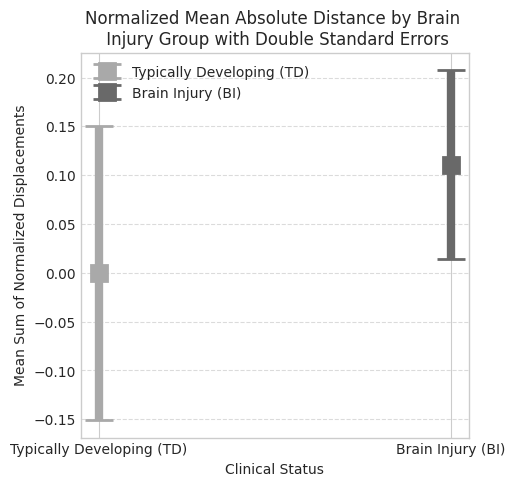

In [73]:
grouped_df = df.groupby('brain_injury')['abs_distance'].agg(['mean', 'sem'])
grouped_df['error'] = grouped_df['sem'] * 2  # double standard error

# Subtract baseline (mean of TD group)
baseline_mean = grouped_df.loc[0, 'mean']
grouped_df['normalized_mean'] = grouped_df['mean'] - baseline_mean

plt.figure(figsize=(5, 5))

# Reduce the spacing between the bars
bar_positions = [1, 3]

# Plot the mean as squares with different colors
plt.errorbar(bar_positions[0], grouped_df['normalized_mean'][0], yerr=grouped_df['error'][0], fmt='s', capsize=10, 
             ecolor='darkgrey', elinewidth=6, markeredgewidth=2, markersize=12, color='darkgrey', label='Typically Developing (TD)')
plt.errorbar(bar_positions[1], grouped_df['normalized_mean'][1], yerr=grouped_df['error'][1], fmt='s', capsize=10, 
             ecolor='dimgrey', elinewidth=6, markeredgewidth=2, markersize=12, color='dimgrey', label='Brain Injury (BI)')

plt.xticks(bar_positions, ['Typically Developing (TD)', 'Brain Injury (BI)'])
plt.xlabel('Clinical Status')
plt.ylabel('Mean Sum of Normalized Displacements')
plt.title('Normalized Mean Absolute Distance by Brain \n Injury Group with Double Standard Errors')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend()
plt.show()

/tmp/ipykernel_13162/293569503.py:25: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-whitegrid')


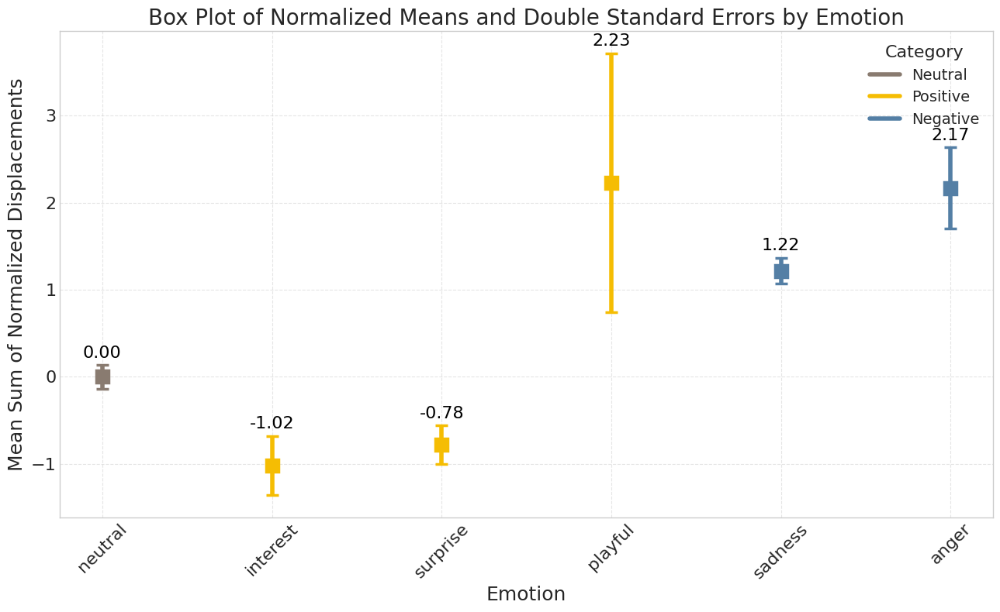

In [74]:
label_encoder = LabelEncoder()
df['emotion_encoded'] = label_encoder.fit_transform(df['emotion'])

# Map encoded values back to emotions and manually order them
ordered_emotions = ['neutral', 'interest', 'surprise', 'playful', 'sadness', 'anger']
df['emotion'] = pd.Categorical(df['emotion'], categories=ordered_emotions, ordered=True)
df.sort_values('emotion', inplace=True)  # Sort based on the custom order

# Convert distances to absolute values
df['abs_distance'] = df['distance'].abs()

# Recalculate emotion_encoded to reflect the new order
df['emotion_encoded'] = label_encoder.fit_transform(df['emotion'])

# Calculate overall means and standard errors
mean_se_overall = df.groupby('emotion_encoded')['abs_distance'].agg(
    mean='mean', se=lambda x: np.std(x) / np.sqrt(len(x)) * 2).reset_index()
mean_se_overall['emotion'] = label_encoder.inverse_transform(mean_se_overall['emotion_encoded'])

# Normalize by setting 'neutral' as baseline
neutral_mean = mean_se_overall.loc[mean_se_overall['emotion'] == 'neutral', 'mean'].values[0]
mean_se_overall['normalized_mean'] = mean_se_overall['mean'] - neutral_mean

# Set the style for the plot
plt.style.use('seaborn-whitegrid')

# Define specific color shades for Neutral, Positive, and Negative categories
color_map = {
    'neutral': '#897b70',  # Grey
    'positive': '#f5bd03',  # Yellow
    'negative': '#547fa5'   # Blue
}

# Assign colors to emotions based on their categories
emotion_color_map = {
    'neutral': color_map['neutral'],
    'interest': color_map['positive'],
    'surprise': color_map['positive'],
    'playful': color_map['positive'],
    'sadness': color_map['negative'],
    'anger': color_map['negative']
}

# Category mapping for the legend
category_legend_map = {
    'neutral': 'Neutral',
    'positive': 'Positive',
    'negative': 'Negative'
}

# Plot the data using error bars and symbolic boxes
fig, ax = plt.subplots(figsize=(13, 8))
x_labels = []
x_ticks = []
legend_handles = {}

for i, emotion in enumerate(ordered_emotions):
    subset = mean_se_overall[mean_se_overall['emotion'] == emotion]
    if not subset.empty:
        category = 'neutral' if emotion == 'neutral' else ('positive' if emotion in ['interest', 'surprise', 'playful'] else 'negative')
        color = emotion_color_map[emotion]
        ax.errorbar(i, subset['normalized_mean'], yerr=subset['se'], fmt='s', capsize=6,
                    elinewidth=4, markeredgewidth=2.5, markersize=12, color=color, label=category_legend_map[category])
        ax.text(i, subset['normalized_mean'] + subset['se'] + 0.05, f"{subset['normalized_mean'].values[0]:.2f}", 
                horizontalalignment='center', verticalalignment='bottom', fontsize=16, color='black')

        x_labels.append(emotion)
        x_ticks.append(i)

        # Create legend handles
        if category_legend_map[category] not in legend_handles:
            legend_handles[category_legend_map[category]] = plt.Line2D([0], [0], color=color, lw=4, label=category_legend_map[category])

ax.set_xlabel('Emotion', fontsize=18)
ax.set_ylabel('Mean Sum of Normalized Displacements', fontsize=18)
ax.set_title('Box Plot of Normalized Means and Double Standard Errors by Emotion', fontsize=20)
ax.set_xticks(x_ticks)
ax.set_xticklabels(x_labels, rotation=45, fontsize=16)
ax.tick_params(axis='y', labelsize=16)
ax.grid(True, linestyle='--', alpha=0.5)

# Add custom legend within the plot area
ax.legend(handles=legend_handles.values(), loc='upper right', title='Category', fontsize=14, title_fontsize=16)

plt.tight_layout()
plt.show()

# Old Plots

Emotion mapping: {0: 'anger', 1: 'interest', 2: 'neutral', 3: 'playful', 4: 'sadness', 5: 'surprise'}


/tmp/ipykernel_60186/4179613130.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['emotion_encoded'] = label_encoder.fit_transform(df['emotion'])
/tmp/ipykernel_60186/4179613130.py:31: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-whitegrid')


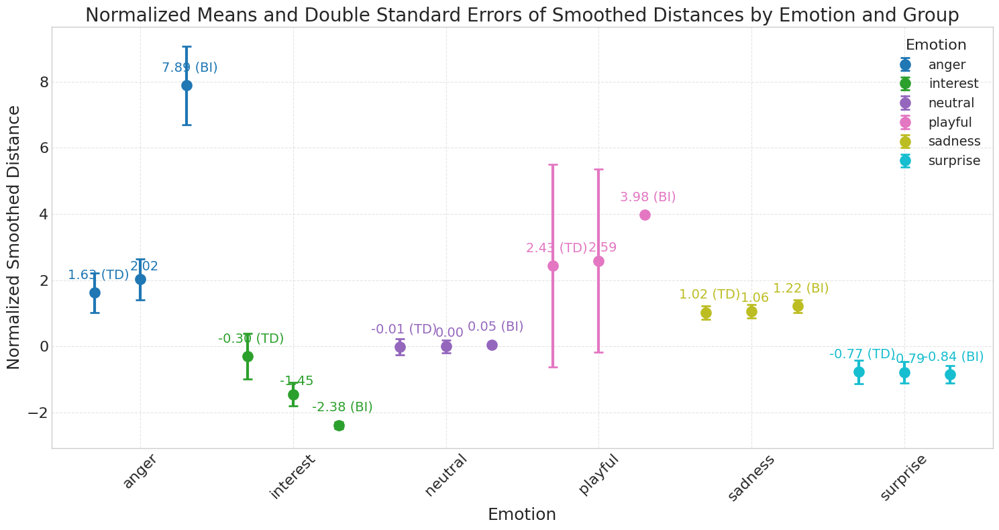

In [120]:
df = df[df['emotion'] != 'sleepy']


label_encoder = LabelEncoder()
df['emotion_encoded'] = label_encoder.fit_transform(df['emotion'])


emotion_mapping = {index: emotion for index, emotion in enumerate(label_encoder.classes_)}
print("Emotion mapping:", emotion_mapping)

mean_se_total = df.groupby('emotion_encoded')['distance'].agg(mean='mean', se=lambda x: np.std(x) / np.sqrt(len(x))*2).reset_index()
mean_se_total['emotion'] = label_encoder.inverse_transform(mean_se_total['emotion_encoded'])
mean_se_total['group'] = 'Total'

mean_se_injured = df[df['brain_injury'] == True].groupby('emotion_encoded')['distance'].agg(mean='mean', se=lambda x: np.std(x) / np.sqrt(len(x) *2)).reset_index()
mean_se_injured['emotion'] = label_encoder.inverse_transform(mean_se_injured['emotion_encoded'])
mean_se_injured['group'] = 'Injured'

mean_se_typical = df[df['brain_injury'] == False].groupby('emotion_encoded')['distance'].agg(mean='mean', se=lambda x: np.std(x) / np.sqrt(len(x)) *2).reset_index()
mean_se_typical['emotion'] = label_encoder.inverse_transform(mean_se_typical['emotion_encoded'])
mean_se_typical['group'] = 'Typical'

# Combine all data
mean_se_combined = pd.concat([mean_se_total, mean_se_injured, mean_se_typical])

# Normalize by setting 'neutral' as baseline for each group
neutral_mean = mean_se_total.loc[mean_se_total['emotion'] == 'neutral', 'mean'].values[0]
mean_se_combined['normalized_mean'] = mean_se_combined['mean'] - neutral_mean

# Set the style for the plot
plt.style.use('seaborn-whitegrid')

# Define colors for each group
base_colors = plt.cm.tab10(np.linspace(0, 1, len(mean_se_combined['emotion'].unique())))
colors_typical = base_colors
colors_total = [tuple(list(c[:3]) + [1]) for c in base_colors]
colors_injured = [tuple(list(c[:3]) + [1]) for c in base_colors]

# Plot the data
plt.figure(figsize=(15, 8))
for i, emotion in enumerate(mean_se_combined['emotion'].unique()):
    for group in ['Typical', 'Total', 'Injured']:
        subset = mean_se_combined[(mean_se_combined['emotion'] == emotion) & (mean_se_combined['group'] == group)]
        if not subset.empty:
            offset = {'Typical': -0.3, 'Total': 0, 'Injured': 0.3}[group]
            color = {'Typical': colors_typical[i], 'Total': colors_total[i], 'Injured': colors_injured[i]}[group]
            plt.errorbar(i + offset, subset['normalized_mean'], yerr=subset['se'], fmt='o', capsize=5,
                         elinewidth=3, markeredgewidth=2, markersize=10, color=color, label=f"{emotion}" if group == 'Total' else "")
            label = f"{subset['normalized_mean'].values[0]:.2f}"
            if group == 'Typical':
                label += ' (TD)'
            elif group == 'Injured':
                label += ' (BI)'
            plt.annotate(label, (i + offset, subset['normalized_mean'].values[0]), 
                         textcoords="offset points", xytext=(4, 10 if group == 'Total' else 15), ha='center', fontsize=14, color=color)

plt.xlabel('Emotion', fontsize=18)
plt.ylabel('Normalized Smoothed Distance', fontsize=18)
plt.title('Normalized Means and Double Standard Errors of Smoothed Distances by Emotion and Group', fontsize=20)
plt.xticks(range(len(mean_se_combined['emotion'].unique())), mean_se_combined['emotion'].unique(), rotation=45, fontsize=16)
plt.yticks(fontsize=16)
plt.grid(True, linestyle='--', alpha=0.5)

# Add legend with only emotions
handles, labels = plt.gca().get_legend_handles_labels()
by_label = dict(zip(labels, handles))
plt.legend(by_label.values(), by_label.keys(), title='Emotion', fontsize=14, title_fontsize=16)

plt.tight_layout()
plt.show()

In [98]:
import statsmodels.api as sm
from statsmodels.formula.api import ols

anova_results = {}

# List of unique emotions
unique_emotions = df['emotion'].unique()

# Perform ANOVA for each emotion
for emotion in unique_emotions:
    # Filter data for current emotion
    emotion_data = df[df['emotion'] == emotion]
    
    # Define the model
    model = ols('distance ~ C(brain_injury)', data=emotion_data).fit()
    
    # Perform ANOVA
    anova_table = sm.stats.anova_lm(model, typ=2)
    
    # Store results in dictionary
    anova_results[emotion] = anova_table

    # Optionally, print results for each emotion
    print(f"ANOVA results for {emotion}:")
    print(anova_table)
    print("\n")

ANOVA results for neutral:
                       sum_sq       df         F    PR(>F)
C(brain_injury)  6.249430e+00      1.0  0.014164  0.905267
Residual         3.279400e+07  74324.0       NaN       NaN


ANOVA results for sadness:
                        sum_sq      df         F    PR(>F)
C(brain_injury)     120.829565     1.0  4.407493  0.035831
Residual         138580.698474  5055.0       NaN       NaN


ANOVA results for surprise:
                       sum_sq      df         F    PR(>F)
C(brain_injury)     27.091208     1.0  1.371727  0.241685
Residual         32547.516366  1648.0       NaN       NaN


ANOVA results for interest:
                       sum_sq      df          F        PR(>F)
C(brain_injury)   2370.821419     1.0  48.020586  5.898577e-12
Residual         86794.110649  1758.0        NaN           NaN


ANOVA results for anger:
                       sum_sq     df          F        PR(>F)
C(brain_injury)   1464.517193    1.0  46.717292  1.965500e-11
Residual        

In [99]:
df

,video,block_id,distance,brain_injury,emotion,emotion_category,emotion_category_2,emotion_encoded
0,r_2021_07_21_833180_003_cam3_vid4,0,6.301087,0,neutral,neutral,neutral,2
4,r_2021_07_21_833180_003_cam3_vid4,4,3.727641,0,neutral,neutral,neutral,2
5,r_2021_07_21_833180_003_cam3_vid4,5,5.251773,0,neutral,neutral,neutral,2
6,r_2021_07_21_833180_003_cam3_vid4,6,5.877077,0,neutral,neutral,neutral,2
7,r_2021_07_21_833180_003_cam3_vid4,7,6.020237,0,neutral,neutral,neutral,2
...,...,...,...,...,...,...,...,...
94135,r_2024_06_07_833180_239_cam3_vid4,358,14.580994,1,neutral,neutral,neutral,2
94136,r_2024_06_07_833180_239_cam3_vid4,359,10.454222,1,neutral,neutral,neutral,2
94137,r_2024_06_07_833180_239_cam3_vid4,360,12.024891,1,neutral,neutral,neutral,2
94138,r_2024_06_07_833180_239_cam3_vid4,361,8.395568,1,neutral,neutral,neutral,2


In [100]:
import pandas as pd
import statsmodels.api as sm
from statsmodels.formula.api import ols

# Assuming 'df' is your DataFrame and it includes 'distance'', 'emotion', and 'brain_injury' columns

# Define the OLS model with interactions
model = ols('distance ~ C(emotion) * C(brain_injury)', data=df).fit()

# Perform the ANOVA
anova_results = sm.stats.anova_lm(model, typ=2)  # Type 2 ANOVA Framework

# Display the results
print(anova_results)

                                  sum_sq       df         F    PR(>F)
C(emotion)                  1.232168e+04      5.0  6.216912  0.000009
C(brain_injury)             8.074021e+00      1.0  0.020369  0.886512
C(emotion):C(brain_injury)  3.991518e+03      5.0  2.013923  0.073298
Residual                    3.307181e+07  83432.0       NaN       NaN


In [113]:
from statsmodels.stats.multicomp import pairwise_tukeyhsd
import statsmodels.api as sm

df['interaction'] = df['emotion'] + "_" + df['brain_injury'].map(str)

# Now perform the Tukey HSD test
tukey = pairwise_tukeyhsd(endog=df['distance'],     # Data
                          groups=df['interaction'], # Groups
                          alpha=0.05)               # Significance level

# Print the summary of the Tukey HSD test
print(tukey.summary())

/tmp/ipykernel_60186/402693079.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['interaction'] = df['emotion'] + "_" + df['brain_injury'].map(str)


     Multiple Comparison of Means - Tukey HSD, FWER=0.05     
  group1     group2   meandiff p-adj   lower    upper  reject
-------------------------------------------------------------
   anger_0    anger_1   6.5712 0.7455  -4.6014 17.7437  False
   anger_0 interest_0  -1.5477 0.9571  -5.0763   1.981  False
   anger_0 interest_1  -3.8763 0.0114  -7.2941 -0.4586   True
   anger_0  neutral_0  -1.7042 0.6501  -4.4051  0.9967  False
   anger_0  neutral_1  -1.6809 0.6918  -4.4237   1.062  False
   anger_0  playful_0   0.7425    1.0 -13.0885 14.5735  False
   anger_0  playful_1  -0.7132    1.0 -27.4122 25.9857  False
   anger_0  sadness_0  -0.6473 0.9999  -3.5188  2.2242  False
   anger_0  sadness_1  -0.2449    1.0  -3.6912  3.2014  False
   anger_0 surprise_0  -2.4942 0.3362  -5.7477  0.7592  False
   anger_0 surprise_1  -2.7959 0.5872  -7.0479  1.4562  False
   anger_1 interest_0  -8.1188 0.4099 -19.2016  2.9639  False
   anger_1 interest_1 -10.4475 0.0845 -21.4955  0.6005  False
   anger

Emotion Category mapping: {0: 'negative', 1: 'neutral', 2: 'positive'}


/tmp/ipykernel_60186/1724815413.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['emotion_category_encoded'] = label_encoder.fit_transform(df['emotion_category'])
/tmp/ipykernel_60186/1724815413.py:31: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-whitegrid')


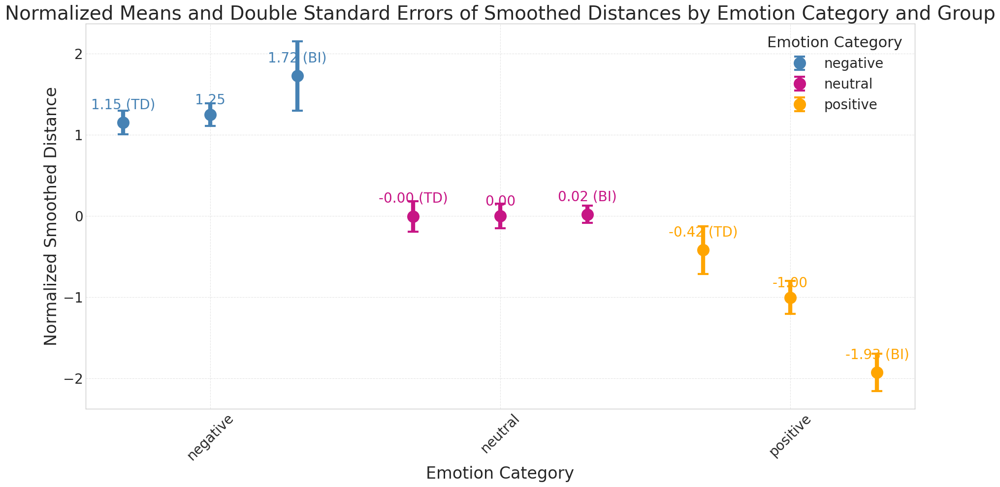

In [104]:
label_encoder = LabelEncoder()
df['emotion_category_encoded'] = label_encoder.fit_transform(df['emotion_category'])

# Create a mapping of encoded labels to emotion categories
emotion_category_mapping = {index: emotion for index, emotion in enumerate(label_encoder.classes_)}
print("Emotion Category mapping:", emotion_category_mapping)

# Compute means and standard errors for total population
mean_se_total = df.groupby('emotion_category_encoded')['distance'].agg(mean='mean', se=lambda x: np.std(x) / np.sqrt(len(x))*2).reset_index()
mean_se_total['emotion_category'] = label_encoder.inverse_transform(mean_se_total['emotion_category_encoded'])
mean_se_total['group'] = 'Total'

# Compute means and standard errors for brain-injured population
mean_se_injured = df[df['brain_injury'] == True].groupby('emotion_category_encoded')['distance'].agg(mean='mean', se=lambda x: np.std(x) / np.sqrt(len(x))*2).reset_index()
mean_se_injured['emotion_category'] = label_encoder.inverse_transform(mean_se_injured['emotion_category_encoded'])
mean_se_injured['group'] = 'Injured'

# Compute means and standard errors for typically developing population
mean_se_typical = df[df['brain_injury'] == False].groupby('emotion_category_encoded')['distance'].agg(mean='mean', se=lambda x: np.std(x) / np.sqrt(len(x))*2).reset_index()
mean_se_typical['emotion_category'] = label_encoder.inverse_transform(mean_se_typical['emotion_category_encoded'])
mean_se_typical['group'] = 'Typical'

# Combine all data
mean_se_combined = pd.concat([mean_se_total, mean_se_injured, mean_se_typical])

# Normalize by setting 'neutral' as baseline for each group
neutral_mean = mean_se_total.loc[mean_se_total['emotion_category'] == 'neutral', 'mean'].values[0]
mean_se_combined['normalized_mean'] = mean_se_combined['mean'] - neutral_mean

# Set the style for the plot
plt.style.use('seaborn-whitegrid')

# Define specific colors for each emotion category
color_map = {
    'negative': 'steelblue',
    'neutral': 'mediumvioletred',
    'positive': 'orange',
    # Add more if needed
}

# Create a list of colors based on the emotion category
colors = [color_map[emotion] for emotion in mean_se_combined['emotion_category'].unique()]

# Plot the data
plt.figure(figsize=(18, 10))
for i, emotion_category in enumerate(mean_se_combined['emotion_category'].unique()):
    for group in ['Typical', 'Total', 'Injured']:
        subset = mean_se_combined[(mean_se_combined['emotion_category'] == emotion_category) & (mean_se_combined['group'] == group)]
        if not subset.empty:
            offset = {'Typical': -0.3, 'Total': 0, 'Injured': 0.3}[group]
            color = {'Typical': colors[i], 'Total': colors[i], 'Injured': colors[i]}[group]
            plt.errorbar(i + offset, subset['normalized_mean'], yerr=subset['se'], fmt='o', capsize=8,
                         elinewidth=6, markeredgewidth=3, markersize=15, color=color, label=f"{emotion_category}" if group == 'Total' else "")
            label = f"{subset['normalized_mean'].values[0]:.2f}"
            if group == 'Typical':
                label += ' (TD)'
            elif group == 'Injured':
                label += ' (BI)'
            plt.annotate(label, (i + offset, subset['normalized_mean'].values[0]), 
                         textcoords="offset points", xytext=(0, 15 if group == 'Total' else 20), ha='center', fontsize=20, color=color)

plt.xlabel('Emotion Category', fontsize=24)
plt.ylabel('Normalized Smoothed Distance', fontsize=24)
plt.title('Normalized Means and Double Standard Errors of Smoothed Distances by Emotion Category and Group', fontsize=28)
plt.xticks(range(len(mean_se_combined['emotion_category'].unique())), mean_se_combined['emotion_category'].unique(), rotation=45, fontsize=20)
plt.yticks(fontsize=20)
plt.grid(True, linestyle='--', alpha=0.5)

# Add legend with only emotions
handles, labels = plt.gca().get_legend_handles_labels()
by_label = dict(zip(labels, handles))
plt.legend(by_label.values(), by_label.keys(), title='Emotion Category', fontsize=20, title_fontsize=22)

plt.tight_layout()
plt.show()

In [109]:
model = ols('distance ~ C(emotion_category) * C(brain_injury)', data=df).fit()

# Perform the ANOVA
anova_results = sm.stats.anova_lm(model, typ=2)  # Type 2 ANOVA Framework

# Display the results
print(anova_results)

                                           sum_sq       df          F  \
C(emotion_category)                  1.201118e+04      2.0  15.150676   
C(brain_injury)                      1.670770e+01      1.0   0.042150   
C(emotion_category):C(brain_injury)  2.057081e+03      2.0   2.594764   
Residual                             3.307405e+07  83438.0        NaN   

                                           PR(>F)  
C(emotion_category)                  2.638393e-07  
C(brain_injury)                      8.373354e-01  
C(emotion_category):C(brain_injury)  7.466955e-02  
Residual                                      NaN  


Emotion Category mapping: {0: 'intense', 1: 'mild', 2: 'neutral'}


/tmp/ipykernel_60186/524928731.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['emotion_category_encoded'] = label_encoder.fit_transform(df['emotion_category_2'])
/tmp/ipykernel_60186/524928731.py:31: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-whitegrid')


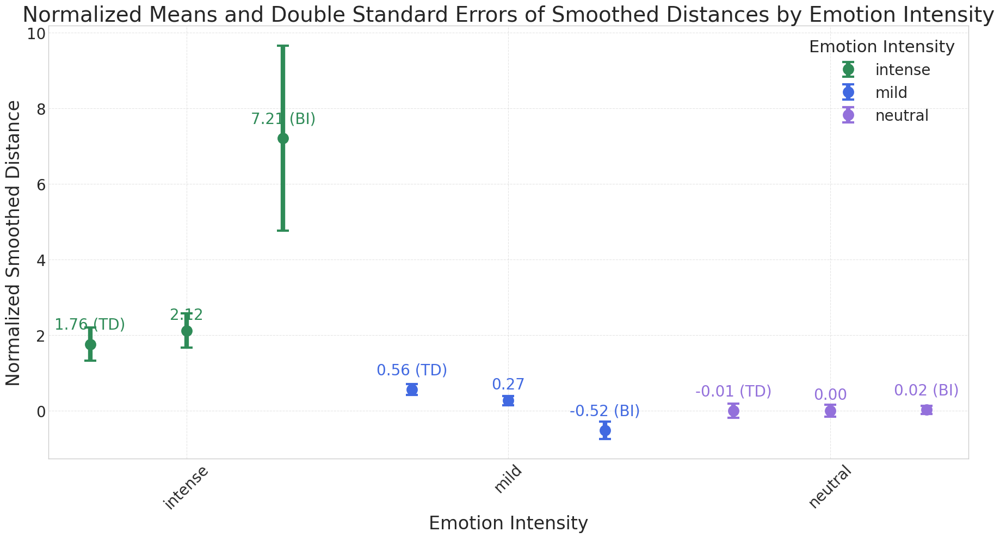

In [110]:
label_encoder = LabelEncoder()
df['emotion_category_encoded'] = label_encoder.fit_transform(df['emotion_category_2'])

# Create a mapping of encoded labels to emotion categories
emotion_category_mapping = {index: emotion for index, emotion in enumerate(label_encoder.classes_)}
print("Emotion Category mapping:", emotion_category_mapping)

# Compute means and standard errors for total population
mean_se_total = df.groupby('emotion_category_encoded')['distance'].agg(mean='mean', se=lambda x: np.std(x) / np.sqrt(len(x))*2).reset_index()
mean_se_total['emotion_category_2'] = label_encoder.inverse_transform(mean_se_total['emotion_category_encoded'])
mean_se_total['group'] = 'Total'

# Compute means and standard errors for brain-injured population
mean_se_injured = df[df['brain_injury'] == True].groupby('emotion_category_encoded')['distance'].agg(mean='mean', se=lambda x: np.std(x) / np.sqrt(len(x))*2).reset_index()
mean_se_injured['emotion_category_2'] = label_encoder.inverse_transform(mean_se_injured['emotion_category_encoded'])
mean_se_injured['group'] = 'Injured'

# Compute means and standard errors for typically developing population
mean_se_typical = df[df['brain_injury'] == False].groupby('emotion_category_encoded')['distance'].agg(mean='mean', se=lambda x: np.std(x) / np.sqrt(len(x))*2).reset_index()
mean_se_typical['emotion_category_2'] = label_encoder.inverse_transform(mean_se_typical['emotion_category_encoded'])
mean_se_typical['group'] = 'Typical'

# Combine all data
mean_se_combined = pd.concat([mean_se_total, mean_se_injured, mean_se_typical])

# Normalize by setting 'neutral' as baseline for each group
neutral_mean = mean_se_total.loc[mean_se_total['emotion_category_2'] == 'neutral', 'mean'].values[0]
mean_se_combined['normalized_mean'] = mean_se_combined['mean'] - neutral_mean

# Set the style for the plot
plt.style.use('seaborn-whitegrid')

# Define specific colors for each emotion category
color_map = {
    'intense': 'seagreen',
    'mild': 'royalblue',
    'neutral': 'mediumpurple',
    # Add more if needed
}

# Create a list of colors based on the emotion category
colors = [color_map[emotion] for emotion in mean_se_combined['emotion_category_2'].unique()]

# Plot the data
plt.figure(figsize=(18, 10))
for i, emotion_category in enumerate(mean_se_combined['emotion_category_2'].unique()):
    for group in ['Typical', 'Total', 'Injured']:
        subset = mean_se_combined[(mean_se_combined['emotion_category_2'] == emotion_category) & (mean_se_combined['group'] == group)]
        if not subset.empty:
            offset = {'Typical': -0.3, 'Total': 0, 'Injured': 0.3}[group]
            color = {'Typical': colors[i], 'Total': colors[i], 'Injured': colors[i]}[group]
            plt.errorbar(i + offset, subset['normalized_mean'], yerr=subset['se'], fmt='o', capsize=8,
                         elinewidth=6, markeredgewidth=3, markersize=12, color=color, label=f"{emotion_category}" if group == 'Total' else "")
            label = f"{subset['normalized_mean'].values[0]:.2f}"
            if group == 'Typical':
                label += ' (TD)'
            elif group == 'Injured':
                label += ' (BI)'
            plt.annotate(label, (i + offset, subset['normalized_mean'].values[0]), 
                         textcoords="offset points", xytext=(0, 15 if group == 'Total' else 20), ha='center', fontsize=20, color=color)

plt.xlabel('Emotion Intensity', fontsize=24)
plt.ylabel('Normalized Smoothed Distance', fontsize=24)
plt.title('Normalized Means and Double Standard Errors of Smoothed Distances by Emotion Intensity', fontsize=28)
plt.xticks(range(len(mean_se_combined['emotion_category_2'].unique())), mean_se_combined['emotion_category_2'].unique(), rotation=45, fontsize=20)
plt.yticks(fontsize=20)
plt.grid(True, linestyle='--', alpha=0.5)

# Add legend with only emotions
handles, labels = plt.gca().get_legend_handles_labels()
by_label = dict(zip(labels, handles))
plt.legend(by_label.values(), by_label.keys(), title='Emotion Intensity', fontsize=20, title_fontsize=22)

plt.tight_layout()
plt.show()

In [111]:
anova_results = {}

# List of unique emotions
unique_emotions = df['emotion_category_2'].unique()

# Perform ANOVA for each emotion
for emotion in unique_emotions:
    # Filter data for current emotion
    emotion_data = df[df['emotion_category_2'] == emotion]
    
    # Define the model
    model = ols('distance ~ C(brain_injury)', data=emotion_data).fit()
    
    # Perform ANOVA
    anova_table = sm.stats.anova_lm(model, typ=2)
    
    # Store results in dictionary
    anova_results[emotion] = anova_table

    # Optionally, print results for each emotion
    print(f"ANOVA results for {emotion}:")
    print(anova_table)
    print("\n")

ANOVA results for neutral:
                       sum_sq       df         F    PR(>F)
C(brain_injury)  8.822497e+00      1.0  0.019939  0.887707
Residual         3.278758e+07  74102.0       NaN       NaN


ANOVA results for mild:
                        sum_sq      df          F        PR(>F)
C(brain_injury)    1995.399611     1.0  63.373398  1.925594e-15
Residual         273427.824498  8684.0        NaN           NaN


ANOVA results for intense:
                       sum_sq     df          F        PR(>F)
C(brain_injury)   1195.158208    1.0  37.731003  1.412395e-09
Residual         20652.595908  652.0        NaN           NaN




In [112]:
model = ols('distance ~ C(emotion_category_2) * C(brain_injury)', data=df).fit()

# Perform the ANOVA
anova_results = sm.stats.anova_lm(model, typ=2)  # Type 2 ANOVA Framework

# Display the results
print(anova_results)

                                             sum_sq       df         F  \
C(emotion_category_2)                  3.394870e+03      2.0  4.281242   
C(brain_injury)                        1.298207e+02      1.0  0.327432   
C(emotion_category_2):C(brain_injury)  3.069560e+03      2.0  3.870996   
Residual                               3.308166e+07  83438.0       NaN   

                                         PR(>F)  
C(emotion_category_2)                  0.013829  
C(brain_injury)                        0.567177  
C(emotion_category_2):C(brain_injury)  0.020841  
Residual                                    NaN  


# Plotting corelations without clin data

In [124]:
# Perform ANOVA
anova_results = f_oneway(*[df[df['emotion_encoded'] == i]['distance'] for i in df['emotion_encoded'].unique()])
print(f"ANOVA results: F = {anova_results.statistic}, p = {anova_results.pvalue:.10f}")

# Perform posthoc test if ANOVA is significant
if anova_results.pvalue < 0.05:
    posthoc = pairwise_tukeyhsd(df['distance'], df['emotion_encoded'], alpha=0.05)
    posthoc_results = posthoc.summary()
    print(posthoc_results)

ANOVA results: F = 3.963487545450274, p = 0.0013544542
 Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1 group2 meandiff p-adj   lower    upper  reject
-----------------------------------------------------
     0      1  -3.4762 0.0351  -6.8099 -0.1425   True
     0      2  -2.0246 0.3246  -4.8654  0.8163  False
     0      3   0.5633    1.0 -16.3126 17.4393  False
     0      4  -0.9646 0.9431  -3.9721  2.0428  False
     0      5  -2.8146 0.1722  -6.2197  0.5905  False
     1      2   1.4516 0.1866  -0.3328   3.236  False
     1      3   4.0395 0.9833 -12.6911   20.77  False
     1      4   2.5115  0.006   0.4723  4.5508   True
     1      5   0.6616 0.9786  -1.9285  3.2516  False
     2      3   2.5879 0.9979 -14.0515 19.2272  False
     2      4   1.0599 0.0486   0.0038  2.1161   True
     2      5  -0.7901 0.8484  -2.7046  1.1245  False
     3      4   -1.528 0.9998 -18.1966 15.1407  False
     3      5  -3.3779 0.9927 -20.1229  13.367  False
     4      5    -1.85 0.14

ANOVA results: F = 3.963487545450274, p = 0.0013544542030791624
 Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1 group2 meandiff p-adj   lower    upper  reject
-----------------------------------------------------
     0      1  -3.4762 0.0351  -6.8099 -0.1425   True
     0      2  -2.0246 0.3246  -4.8654  0.8163  False
     0      3   0.5633    1.0 -16.3126 17.4393  False
     0      4  -0.9646 0.9431  -3.9721  2.0428  False
     0      5  -2.8146 0.1722  -6.2197  0.5905  False
     1      2   1.4516 0.1866  -0.3328   3.236  False
     1      3   4.0395 0.9833 -12.6911   20.77  False
     1      4   2.5115  0.006   0.4723  4.5508   True
     1      5   0.6616 0.9786  -1.9285  3.2516  False
     2      3   2.5879 0.9979 -14.0515 19.2272  False
     2      4   1.0599 0.0486   0.0038  2.1161   True
     2      5  -0.7901 0.8484  -2.7046  1.1245  False
     3      4   -1.528 0.9998 -18.1966 15.1407  False
     3      5  -3.3779 0.9927 -20.1229  13.367  False
     4      5    -

/tmp/ipykernel_60186/699016379.py:26: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-whitegrid')


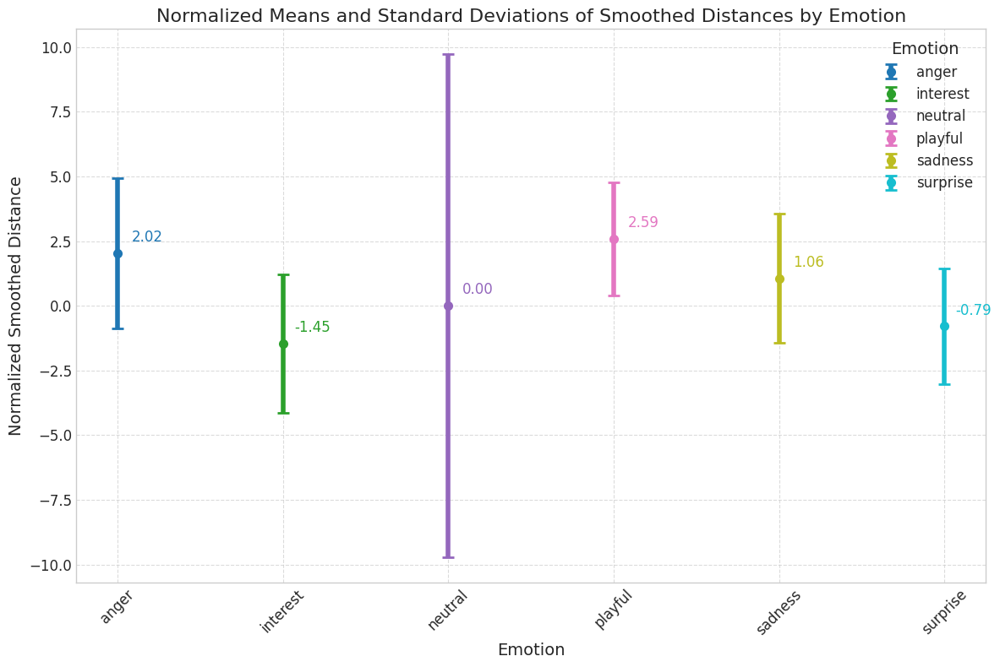

In [125]:
# Exclude 'aversion' emotion
df = df[df['emotion'] != 'sleepy']

# Encode the emotion labels
label_encoder = LabelEncoder()
df['emotion_encoded'] = label_encoder.fit_transform(df['emotion'])

# Perform ANOVA
anova_results = f_oneway(*[df[df['emotion_encoded'] == i]['distance'] for i in df['emotion_encoded'].unique()])
print(f"ANOVA results: F = {anova_results.statistic}, p = {anova_results.pvalue}")

# Perform posthoc test if ANOVA is significant
if anova_results.pvalue < 0.05:
    posthoc = pairwise_tukeyhsd(df['distance'], df['emotion_encoded'], alpha=0.05)
    print(posthoc)

# Compute means and half of standard deviations
mean_sd_df = df.groupby('emotion_encoded')['distance'].agg(mean='mean', half_std=lambda x: np.std(x) / 2).reset_index()
mean_sd_df['emotion'] = label_encoder.inverse_transform(mean_sd_df['emotion_encoded'])

# Normalize by setting 'neutral' as baseline
neutral_mean = mean_sd_df.loc[mean_sd_df['emotion'] == 'neutral', 'mean'].values[0]
mean_sd_df['normalized_mean'] = mean_sd_df['mean'] - neutral_mean

# Set the style for the plot
plt.style.use('seaborn-whitegrid')

# Define colors for each emotion
colors = plt.cm.tab10(np.linspace(0, 1, len(mean_sd_df['emotion'].unique())))

# Plot the data
plt.figure(figsize=(12, 8))
for i, emotion in enumerate(mean_sd_df['emotion']):
    plt.errorbar(emotion, mean_sd_df.loc[i, 'normalized_mean'], yerr=mean_sd_df.loc[i, 'half_std'], fmt='o', capsize=5,
                 elinewidth=4, markeredgewidth=2, color=colors[i], label=emotion)

plt.xlabel('Emotion', fontsize=14)
plt.ylabel('Normalized Smoothed Distance', fontsize=14)
plt.title('Normalized Means and Standard Deviations of Smoothed Distances by Emotion', fontsize=16)
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)
plt.grid(True, linestyle='--', alpha=0.7)

# Add annotations for better readability
for i in range(len(mean_sd_df)):
    plt.annotate(f"{mean_sd_df['normalized_mean'][i]:.2f}", (mean_sd_df['emotion'][i], mean_sd_df['normalized_mean'][i]), 
                 textcoords="offset points", xytext=(25,10), ha='center', fontsize=12, color=colors[i])

# Add legend
plt.legend(title='Emotion', fontsize=12, title_fontsize=14)
plt.tight_layout()
plt.show()

ANOVA results: F = 10.974074263586669, p = 0.0000171823
Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1 group2 meandiff p-adj   lower   upper  reject
----------------------------------------------------
     0      1  -1.2988 0.0002 -2.0605 -0.5371   True
     0      2  -2.3356 0.0001 -3.6254 -1.0458   True
     1      2  -1.0368 0.0621 -2.1135  0.0399  False
----------------------------------------------------
Emotion Category mapping: {0: 'negative', 1: 'neutral', 2: 'positive'}


/tmp/ipykernel_60186/1807575318.py:30: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-whitegrid')


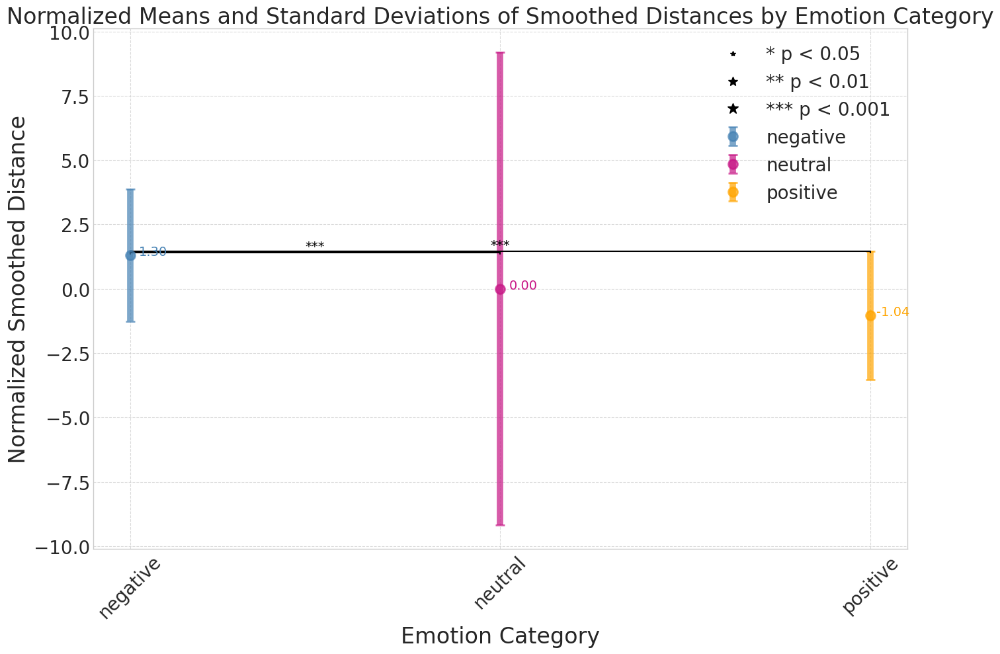

In [126]:
df = merged_df.copy()

# Encode the emotion categories
label_encoder = LabelEncoder()
df['emotion_category_encoded'] = label_encoder.fit_transform(df['emotion_category'])

# Perform ANOVA
anova_results = f_oneway(*[df[df['emotion_category_encoded'] == i]['distance'] for i in df['emotion_category_encoded'].unique()])
print(f"ANOVA results: F = {anova_results.statistic}, p = {anova_results.pvalue:.10f}")

# Perform posthoc test if ANOVA is significant
if anova_results.pvalue < 0.05:
    posthoc = pairwise_tukeyhsd(df['distance'], df['emotion_category_encoded'], alpha=0.05)
    posthoc_results = posthoc.summary()
    print(posthoc_results)

# Create a mapping of encoded labels to emotion categories
emotion_category_mapping = {index: emotion for index, emotion in enumerate(label_encoder.classes_)}
print("Emotion Category mapping:", emotion_category_mapping)

# Compute means and half of standard deviations
mean_sd_df = df.groupby('emotion_category_encoded')['distance'].agg(mean='mean', half_std=lambda x: np.std(x) / 2).reset_index()
mean_sd_df['emotion_category'] = label_encoder.inverse_transform(mean_sd_df['emotion_category_encoded'])

# Normalize by setting 'neutral' as baseline
neutral_mean = mean_sd_df.loc[mean_sd_df['emotion_category'] == 'neutral', 'mean'].values[0]
mean_sd_df['normalized_mean'] = mean_sd_df['mean'] - neutral_mean

# Set the style for the plot
plt.style.use('seaborn-whitegrid')

# Define specific colors for each emotion category
color_map = {
    'negative': 'steelblue',
    'neutral': 'mediumvioletred',
    'positive': 'orange',
    # Add more if needed
}

# Create a list of colors based on the emotion category
colors = [color_map[emotion] for emotion in mean_sd_df['emotion_category']]

# Plot the data
plt.figure(figsize=(14, 10))
for i, emotion_category in enumerate(mean_sd_df['emotion_category']):
    plt.errorbar(emotion_category, mean_sd_df.loc[i, 'normalized_mean'], yerr=mean_sd_df.loc[i, 'half_std'], fmt='o', capsize=5,
                 elinewidth=7, markeredgewidth=2, color=colors[i], label=emotion_category, markersize=10, alpha=0.7)

plt.xlabel('Emotion Category', fontsize=24)
plt.ylabel('Normalized Smoothed Distance', fontsize=24)
plt.title('Normalized Means and Standard Deviations of Smoothed Distances by Emotion Category', fontsize=24)
plt.xticks(rotation=45, fontsize=20)
plt.yticks(fontsize=20)
plt.grid(True, linestyle='--', alpha=0.7)

# Add annotations for better readability
for i in range(len(mean_sd_df)):
    plt.annotate(f"{mean_sd_df['normalized_mean'][i]:.2f}", 
                 (mean_sd_df['emotion_category'][i], mean_sd_df['normalized_mean'][i]), 
                 textcoords="offset points", xytext=(25,0), ha='center', fontsize=14, color=colors[i])

# Add significance stars based on posthoc test p-values
comparisons = pd.DataFrame(data=posthoc._results_table.data[1:], columns=posthoc._results_table.data[0])
comparisons['group1'] = comparisons['group1'].astype(int)
comparisons['group2'] = comparisons['group2'].astype(int)

y_offset = 0.05  # Offset for each line to avoid overlapping
for index, row in comparisons.iterrows():
    group1 = row['group1']
    group2 = row['group2']
    p_value = row['p-adj']
    reject = row['reject']
    if reject:
        star = ''
        if p_value < 0.001:
            star = '***'
        elif p_value < 0.01:
            star = '**'
        elif p_value < 0.05:
            star = '*'
        if star:
            # Calculate the middle point between the two categories
            x1, x2 = mean_sd_df.loc[mean_sd_df['emotion_category_encoded'] == group1, 'emotion_category'].values[0], \
                     mean_sd_df.loc[mean_sd_df['emotion_category_encoded'] == group2, 'emotion_category'].values[0]
            y = max(mean_sd_df.loc[mean_sd_df['emotion_category_encoded'] == group1, 'normalized_mean'].values[0],
                    mean_sd_df.loc[mean_sd_df['emotion_category_encoded'] == group2, 'normalized_mean'].values[0]) + 0.1 + y_offset * index
            plt.plot([x1, x2], [y, y], color='black', lw=1.5)
            plt.plot([x1, x1], [y - y_offset, y], color='black', lw=1.5)
            plt.plot([x2, x2], [y - y_offset, y], color='black', lw=1.5)
            plt.text((list(emotion_category_mapping.values()).index(x1) + list(emotion_category_mapping.values()).index(x2)) / 2, y, star,
                     ha='center', va='bottom', color='black', fontsize=14)

# Add legend with significance stars explanation
handles, labels = plt.gca().get_legend_handles_labels()
extra = plt.Line2D([0], [0], linestyle='none', marker='*', color='black')
extra2 = plt.Line2D([0], [0], linestyle='none', marker='*', color='black', markersize=10, label='** p < 0.01')
extra3 = plt.Line2D([0], [0], linestyle='none', marker='*', color='black', markersize=12, label='*** p < 0.001')
plt.legend(handles=[extra, extra2, extra3] + handles, labels=['* p < 0.05', '** p < 0.01', '*** p < 0.001'] + labels, title='', fontsize=20, title_fontsize=20)

plt.tight_layout()
plt.show()

ANOVA results: F = 3.345811619999548, p = 0.0352396139
Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1 group2 meandiff p-adj   lower   upper  reject
----------------------------------------------------
     0      1  -1.8963 0.1195 -4.1514  0.3588  False
     0      2  -2.1991 0.0477 -4.3807 -0.0175   True
     1      2  -0.3028 0.5026 -0.9373  0.3317  False
----------------------------------------------------
Emotion Category mapping: {0: 'intense', 1: 'mild', 2: 'neutral'}


/tmp/ipykernel_60186/3114878345.py:30: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-whitegrid')


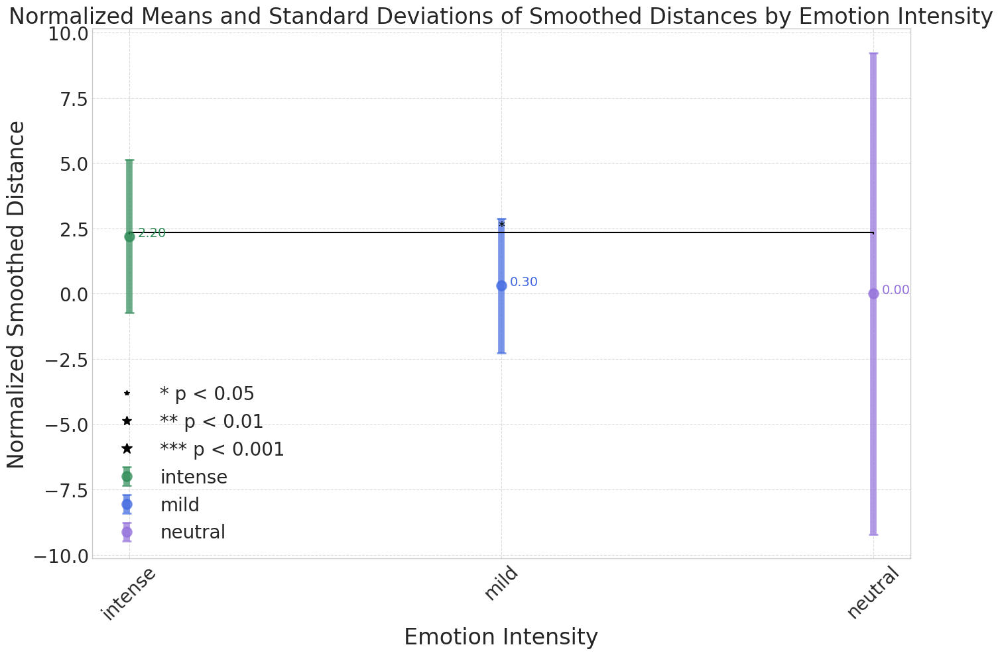

In [127]:
df = merged_df.copy()

# Encode the emotion categories
label_encoder = LabelEncoder()
df['emotion_category_encoded'] = label_encoder.fit_transform(df['emotion_category_2'])

# Perform ANOVA
anova_results = f_oneway(*[df[df['emotion_category_encoded'] == i]['distance'] for i in df['emotion_category_encoded'].unique()])
print(f"ANOVA results: F = {anova_results.statistic}, p = {anova_results.pvalue:.10f}")

# Perform posthoc test if ANOVA is significant
if anova_results.pvalue < 0.05:
    posthoc = pairwise_tukeyhsd(df['distance'], df['emotion_category_encoded'], alpha=0.05)
    posthoc_results = posthoc.summary()
    print(posthoc_results)

# Create a mapping of encoded labels to emotion categories
emotion_category_mapping = {index: emotion for index, emotion in enumerate(label_encoder.classes_)}
print("Emotion Category mapping:", emotion_category_mapping)

# Compute means and half of standard deviations
mean_sd_df = df.groupby('emotion_category_encoded')['distance'].agg(mean='mean', half_std=lambda x: np.std(x) / 2).reset_index()
mean_sd_df['emotion_category_2'] = label_encoder.inverse_transform(mean_sd_df['emotion_category_encoded'])

# Normalize by setting 'neutral' as baseline
neutral_mean = mean_sd_df.loc[mean_sd_df['emotion_category_2'] == 'neutral', 'mean'].values[0]
mean_sd_df['normalized_mean'] = mean_sd_df['mean'] - neutral_mean

# Set the style for the plot
plt.style.use('seaborn-whitegrid')

# Define specific colors for each emotion category
color_map = {
    'intense': 'seagreen',
    'mild': 'royalblue',
    'neutral': 'mediumpurple',
    # Add more if needed
}

# Create a list of colors based on the emotion category
colors = [color_map[emotion] for emotion in mean_sd_df['emotion_category_2']]

# Plot the data
plt.figure(figsize=(14, 10))
for i, emotion_category in enumerate(mean_sd_df['emotion_category_2']):
    plt.errorbar(emotion_category, mean_sd_df.loc[i, 'normalized_mean'], yerr=mean_sd_df.loc[i, 'half_std'], fmt='o', capsize=5,
                 elinewidth=7, markeredgewidth=2, color=colors[i], label=emotion_category, markersize=10, alpha=0.7)

plt.xlabel('Emotion Intensity', fontsize=24)
plt.ylabel('Normalized Smoothed Distance', fontsize=24)
plt.title('Normalized Means and Standard Deviations of Smoothed Distances by Emotion Intensity', fontsize=24)
plt.xticks(rotation=45, fontsize=20)
plt.yticks(fontsize=20)
plt.grid(True, linestyle='--', alpha=0.7)

# Add annotations for better readability
for i in range(len(mean_sd_df)):
    plt.annotate(f"{mean_sd_df['normalized_mean'][i]:.2f}", 
                 (mean_sd_df['emotion_category_2'][i], mean_sd_df['normalized_mean'][i]), 
                 textcoords="offset points", xytext=(25,0), ha='center', fontsize=14, color=colors[i])

# Add significance stars based on posthoc test p-values
comparisons = pd.DataFrame(data=posthoc._results_table.data[1:], columns=posthoc._results_table.data[0])
comparisons['group1'] = comparisons['group1'].astype(int)
comparisons['group2'] = comparisons['group2'].astype(int)

y_offset = 0.05  # Offset for each line to avoid overlapping
for index, row in comparisons.iterrows():
    group1 = row['group1']
    group2 = row['group2']
    p_value = row['p-adj']
    reject = row['reject']
    if reject:
        star = ''
        if p_value < 0.001:
            star = '***'
        elif p_value < 0.01:
            star = '**'
        elif p_value < 0.05:
            star = '*'
        if star:
            # Calculate the middle point between the two categories
            x1, x2 = mean_sd_df.loc[mean_sd_df['emotion_category_encoded'] == group1, 'emotion_category_2'].values[0], \
                     mean_sd_df.loc[mean_sd_df['emotion_category_encoded'] == group2, 'emotion_category_2'].values[0]
            y = max(mean_sd_df.loc[mean_sd_df['emotion_category_encoded'] == group1, 'normalized_mean'].values[0],
                    mean_sd_df.loc[mean_sd_df['emotion_category_encoded'] == group2, 'normalized_mean'].values[0]) + 0.1 + y_offset * index
            plt.plot([x1, x2], [y, y], color='black', lw=1.5)
            plt.plot([x1, x1], [y - y_offset, y], color='black', lw=1.5)
            plt.plot([x2, x2], [y - y_offset, y], color='black', lw=1.5)
            plt.text((list(emotion_category_mapping.values()).index(x1) + list(emotion_category_mapping.values()).index(x2)) / 2, y, star,
                     ha='center', va='bottom', color='black', fontsize=14)

# Add legend with significance stars explanation
handles, labels = plt.gca().get_legend_handles_labels()
extra = plt.Line2D([0], [0], linestyle='none', marker='*', color='black')
extra2 = plt.Line2D([0], [0], linestyle='none', marker='*', color='black', markersize=10, label='** p < 0.01')
extra3 = plt.Line2D([0], [0], linestyle='none', marker='*', color='black', markersize=12, label='*** p < 0.001')
plt.legend(handles=[extra, extra2, extra3] + handles, labels=['* p < 0.05', '** p < 0.01', '*** p < 0.001'] + labels, title='', fontsize=20, title_fontsize=20)

plt.tight_layout()
plt.show()